###### Numpy - 

Numpy is the fundamental package for scientific computing in Python.

It provides the multi-dimensional array object, various derived objects(such as masked arrays and matrices), an assortment of routines for fast operations on arrays, including mathematical, logical, shape manipulation, sorting, selecting I/O, discrete Fourier transforms, basic linear algebra, basic statistical operations, random simulation and more.
    
At the core of numpy package is the ndarray object. This encapsulates n-dimensional arrays of homogenous data types, with many operations being performed in compiled code for performance. 
    
Differences between numpy arrays and python sequences:
    
1. Numpy arrays have fixed size at creation, unlike python lists(which can grow dynamically). Changing the size of ndarray will create a new array and delete the original.
    
2. The elements in a Numpy array are all required to be of same datatype, and thus will be the same size in memory. The exception: one can have arrays of (Python, including Numpy) objects, thereby allowing for arrays of different sized elements.
    
3. Numpy arrays facilitate advanced mathematical and other types of operations on large numbers of data. Typically, such operations are executed more efficiently and with less code than is possible using Python's built-in sequences.
    
4. Most packages are designed to use python arrays for efficiency. As they are memory efficient as well as have faster operations.
    
5. The main benefits of using NumPy arrays should be smaller memory consumption and better runtime behavior. 

    For Python Lists -  We can conclude from this that for every new element, we need another eight bytes for the reference to the new object. The new integer object itself consumes 28 bytes. The size of a list "lst" without the size of the elements can be calculated with:

    64 + 8 * len(lst) +  len(lst) * 28

    NumPy takes up less space. This means that an arbitrary integer array of length "n" in numpy needs

    96 + n * 8 Bytes

6. Numpy is faster due to vectorization.
   -- Vectorized code is concise and easier to read.
   -- Fewer lines of code generally means fewer bugs.
   -- code more closely resembles standard mathematical notation (making it easier, typically, to correctly code mathematical constructs)
   -- vectorization results in more 'pythonic' code. Without vectorization, our code would be inefficient and difficult to read for loops. 
   
7. Broadcasting - 
   is the term used to describe implicit element-by-element behavior of operations, generally speaking in Numpy in all operations, not jusr arithmetic operations, but logical, bit-wise, functional etc behave in this implicit element-by-element fashion. i.e. they broadcast. 
   
8. Numpy supports object-oriented approach. Starting with ndarray.
   For example ndarray is a class possessing numerous methods and attributes. many of its methods are mirrored by functions in the outer-most Numpy namespace, allowing programmer to code in whichever paradigm they prefer. 

In [3]:
import time
import numpy as np

size_of_vec = 1000000000 #1 billion

def pure_python_version():
    t1 = time.time()
    X = range(size_of_vec)
    Y = range(size_of_vec)
    Z = [X[i] + Y[i] for i in range(len(X)) ]
    return time.time() - t1

def numpy_version():
    t1 = time.time()
    X = np.arange(size_of_vec)
    Y = np.arange(size_of_vec)
    Z = X + Y
    return time.time() - t1


t1 = pure_python_version()
t2 = numpy_version()
print(t1, t2)
print("Numpy is in this example " + str(t1/t2) + " faster!")


386.4387421607971 4.732355117797852
Numpy is in this example 81.6588638302829 faster!


###### Basics

1. Numpy's main object is homogenous multidimensional array. It is a table of elements, all of same type, indexed by a tuple of non-negative integers. In Numpy dimensions are called axes. 

    For ex, the coordinates of the point in 3D space[1,2,1] has one axis. That axis has 3 elements in it, so we say it has length of 3.
    
    Likewise, the following array has 2 axes. THe first axes has length of 2, the second has length of 3.
    
    [[1.,0.,0.],
    [0.,1.,2.]]

2. Numpy array class is called ndarray. Note that numpy.array is not the same as the standard python library class array.array wich handles one-dimensional arrys and offers less functionality.

3. Most important attributes of numpy array or ndarray object are:
    1. ndarray.dim - number of axes(dimensions) of the array.
    2. ndarray.shape - dimensions of the array. This is a tuple of integers indicating the size of the array in each dimension. For a matrix with n rows and m columns, shape will be (n,m). Length of shape tuple is therefore number of axes ndim.
    3. ndarray.size - total number of elements of array. This is equal to product of the elements of shape.
    4. ndarray.dtype - an object describing the type of the elements in the aarry. Numpy provides it own types -     numpy.int32, numpy.int16, numpy.float64 etc.
    5. ndarray.itemsize - size in bytes of each elements of the array. 
    6. ndarray.data = buffer contaiing the actual elements of the array.
    
    
    


In [11]:
import numpy as np

a = np.arange(15).reshape(3,5)
print(a)
print(a.shape)
print(a.ndim)
print(a.itemsize)
print(a.size)
print(type(a))
print(a.data)
print('memory utilized: ', a.size * a.itemsize)

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]]
(3, 5)
2
4
15
<class 'numpy.ndarray'>
memory utilized:  60


###### Array Creation

There are several ways to create numpy array. 

1. creating using python list or tuple using array function.

In [14]:
import numpy as np

a = np.array([2,3,4])
b = np.array([1.2, 2.5, 5.6])
print(a, b)
print(a.dtype, b.dtype)

[2 3 4] [1.2 2.5 5.6]
int32 float64


array transforms sequences of sequences into two-dimensional arrays, sequences of sequences of sequences into three-dimensional arrays, and so on. The type of the array can also be explicitly specified at creation time.

In [16]:
b = np.array([(1.5, 2,3),(4,5,6)])
print(b)

c = np.array([[1,2],[3,4]], dtype=complex)
c

[[1.5 2.  3. ]
 [4.  5.  6. ]]


array([[1.+0.j, 2.+0.j],
       [3.+0.j, 4.+0.j]])

Often, the elements of an array are originally unknown, but its size is known. Hence, NumPy offers several functions to create arrays with initial placeholder content. These minimize the necessity of growing arrays, an expensive operation.

2. The function zeros creates an array full of zeros, the function ones creates an array full of ones, and the function empty creates an array whose initial content is random and depends on the state of the memory. By default, the dtype of the created array is float64.

In [20]:
print(np.zeros((3,4)))
print(np.ones((4,5), dtype=np.int16))
print(np.empty((2,3)))

[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]
[[1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]
 [1 1 1 1 1]]
[[1.5 2.  3. ]
 [4.  5.  6. ]]


To create sequences of numbers, Numpy provides the arange function which is analagous to the python built-in range, but returns an array.

In [23]:
np.arange(10,30,5)
np.arange(0,2,0.3)

array([0. , 0.3, 0.6, 0.9, 1.2, 1.5, 1.8])

When arange is used with floating point arguments, it is generally not possible to predict the number of elements obtained, due to the finite floating point precision. For this reason, it is usually better to use the function linspace that receives as an argument the number of elements that we want, instead of the step

In [24]:
from numpy import pi

np.linspace( 0, 2, 9 )

array([0.  , 0.25, 0.5 , 0.75, 1.  , 1.25, 1.5 , 1.75, 2.  ])

In [25]:
x = np.linspace( 0, 2*pi, 100 )
f = np.sin(x)
f

array([ 0.00000000e+00,  6.34239197e-02,  1.26592454e-01,  1.89251244e-01,
        2.51147987e-01,  3.12033446e-01,  3.71662456e-01,  4.29794912e-01,
        4.86196736e-01,  5.40640817e-01,  5.92907929e-01,  6.42787610e-01,
        6.90079011e-01,  7.34591709e-01,  7.76146464e-01,  8.14575952e-01,
        8.49725430e-01,  8.81453363e-01,  9.09631995e-01,  9.34147860e-01,
        9.54902241e-01,  9.71811568e-01,  9.84807753e-01,  9.93838464e-01,
        9.98867339e-01,  9.99874128e-01,  9.96854776e-01,  9.89821442e-01,
        9.78802446e-01,  9.63842159e-01,  9.45000819e-01,  9.22354294e-01,
        8.95993774e-01,  8.66025404e-01,  8.32569855e-01,  7.95761841e-01,
        7.55749574e-01,  7.12694171e-01,  6.66769001e-01,  6.18158986e-01,
        5.67059864e-01,  5.13677392e-01,  4.58226522e-01,  4.00930535e-01,
        3.42020143e-01,  2.81732557e-01,  2.20310533e-01,  1.58001396e-01,
        9.50560433e-02,  3.17279335e-02, -3.17279335e-02, -9.50560433e-02,
       -1.58001396e-01, -

In [30]:
np.arange(0,2,0.33333333)

array([0.        , 0.33333333, 0.66666666, 0.99999999, 1.33333332,
       1.66666665, 1.99999998])

In [31]:
np.linspace(0,2,6)

array([0. , 0.4, 0.8, 1.2, 1.6, 2. ])

###### Printing Arrays

When you print an array, NumPy displays it in a similar way to nested lists, but with the following layout:

    the last axis is printed from left to right,
    the second-to-last is printed from top to bottom,
    the rest are also printed from top to bottom, with each slice separated from the next by an empty line.

One-dimensional arrays are then printed as rows, bidimensionals as matrices and tridimensionals as lists of matrices.

In [32]:
a = np.arange(6)
print(a)

[0 1 2 3 4 5]


In [33]:
b = np.arange(12).reshape(4,3)
print(b)

[[ 0  1  2]
 [ 3  4  5]
 [ 6  7  8]
 [ 9 10 11]]


In [34]:
c = np.arange(24).reshape(2,3,4)
print(c)

[[[ 0  1  2  3]
  [ 4  5  6  7]
  [ 8  9 10 11]]

 [[12 13 14 15]
  [16 17 18 19]
  [20 21 22 23]]]


If an array is too large to be printed, NumPy automatically skips the central part of the array and only prints the corners:

In [36]:
print(np.arange(10000).reshape(100,100))

[[   0    1    2 ...   97   98   99]
 [ 100  101  102 ...  197  198  199]
 [ 200  201  202 ...  297  298  299]
 ...
 [9700 9701 9702 ... 9797 9798 9799]
 [9800 9801 9802 ... 9897 9898 9899]
 [9900 9901 9902 ... 9997 9998 9999]]


To disable this behaviour and force NumPy to print the entire array, you can change the printing options using set_printoptions.

In [37]:
import sys
np.set_printoptions(threshold=sys.maxsize)

In [38]:
print(np.arange(10000).reshape(100,100))

[[   0    1    2    3    4    5    6    7    8    9   10   11   12   13
    14   15   16   17   18   19   20   21   22   23   24   25   26   27
    28   29   30   31   32   33   34   35   36   37   38   39   40   41
    42   43   44   45   46   47   48   49   50   51   52   53   54   55
    56   57   58   59   60   61   62   63   64   65   66   67   68   69
    70   71   72   73   74   75   76   77   78   79   80   81   82   83
    84   85   86   87   88   89   90   91   92   93   94   95   96   97
    98   99]
 [ 100  101  102  103  104  105  106  107  108  109  110  111  112  113
   114  115  116  117  118  119  120  121  122  123  124  125  126  127
   128  129  130  131  132  133  134  135  136  137  138  139  140  141
   142  143  144  145  146  147  148  149  150  151  152  153  154  155
   156  157  158  159  160  161  162  163  164  165  166  167  168  169
   170  171  172  173  174  175  176  177  178  179  180  181  182  183
   184  185  186  187  188  189  190  191  192  193

###### Basic Operations

Artihmetic operations on arrays apply elementwise. A new array is created and filled witht he result.

In [39]:
a = np.array([20,30,40,50])
b = np.arange(4)
c = a-b
c

array([20, 29, 38, 47])

In [41]:
print(b)
b**2

[0 1 2 3]


array([0, 1, 4, 9], dtype=int32)

In [42]:
print(a)
10*np.sin(a)

[20 30 40 50]


array([ 9.12945251, -9.88031624,  7.4511316 , -2.62374854])

In [43]:
a<35

array([ True,  True, False, False])

Unlike in many matrix languages, the product operator * operates elementwise in NumPy arrays. The matrix product can be performed using the @ operator (in python >=3.5) or the dot function or method:

In [45]:
A = np.arange(4).reshape(2,2)
B = np.arange(4).reshape(2,2)
A * B # elementwise multiplication

array([[0, 1],
       [4, 9]])

In [46]:
A @ B #matrix multiplication

array([[ 2,  3],
       [ 6, 11]])

In [47]:
A.dot(B)

array([[ 2,  3],
       [ 6, 11]])

Some operations, such as += and *=, act in place to modify an existing array rather than create a new one.

In [50]:
rg = np.random.default_rng(1) #create an instance of default random number generator

a = np.ones((2,3), dtype=int)
b = rg.random((2,3))

print(a)
a *= 3
a

[[1 1 1]
 [1 1 1]]


array([[3, 3, 3],
       [3, 3, 3]])

In [51]:
print(b)
b += a
b

[[0.51182162 0.9504637  0.14415961]
 [0.94864945 0.31183145 0.42332645]]


array([[3.51182162, 3.9504637 , 3.14415961],
       [3.94864945, 3.31183145, 3.42332645]])

In [54]:
a += b

UFuncTypeError: Cannot cast ufunc 'add' output from dtype('float64') to dtype('int32') with casting rule 'same_kind'

When operating with arrays of different types, the type of the resulting array corresponds to the more general or precise one (a behavior known as upcasting).

In [59]:
a += int(b)

TypeError: only size-1 arrays can be converted to Python scalars

In [61]:
a = np.ones(3, dtype=np.int32)
b = np.linspace(0, pi, 3)

b.dtype.name

'float64'

In [62]:
c = a+b
c

array([1.        , 2.57079633, 4.14159265])

In [63]:
c.dtype.name

'float64'

In [64]:
d = np.exp(c*1j)
d

array([ 0.54030231+0.84147098j, -0.84147098+0.54030231j,
       -0.54030231-0.84147098j])

In [65]:
d.dtype.name

'complex128'

Many unary operations, such as computing the sum of all the elements in the array, are implemented as methods of the ndarray class.

In [71]:
a = np.random.random((2,3))
a

array([[0.57081468, 0.03517943, 0.63089492],
       [0.38660957, 0.50959635, 0.34840326]])

In [72]:
a.sum()

2.48149822484185

In [73]:
a.min()
a.max()

0.6308949183497994

By default, these operations apply to the array as though it were a list of numbers, regardless of its shape. However, by specifying the axis parameter you can apply an operation along the specified axis of an array:

In [75]:
b = np.arange(12).reshape(3,4)
b

array([[ 0,  1,  2,  3],
       [ 4,  5,  6,  7],
       [ 8,  9, 10, 11]])

In [76]:
b.sum(axis=0)

array([12, 15, 18, 21])

In [78]:
b.sum(axis=1)

array([ 6, 22, 38])

In [79]:
a.cumsum(axis=0)

array([[0.57081468, 0.03517943, 0.63089492],
       [0.95742426, 0.54477579, 0.97929818]])

In [80]:
b.min(axis=1)

array([0, 4, 8])

###### Universal Functions

NumPy provides familiar mathematical functions such as sin, cos, and exp. In NumPy, these are called “universal functions”(ufunc). Within NumPy, these functions operate elementwise on an array, producing an array as output.

In [81]:
B = np.arange(3)
B

array([0, 1, 2])

In [82]:
np.exp(B)

array([1.        , 2.71828183, 7.3890561 ])

In [83]:
np.sin(B)

array([0.        , 0.84147098, 0.90929743])

In [84]:
np.cos(B)

array([ 1.        ,  0.54030231, -0.41614684])

In [86]:
np.add(B,B,B)

array([0, 2, 4])

Some of the other universal functions are:
    
    all, any, apply_along_axis, argmax, argmin, argsort, average, bincount, ceil, clip, conj, corrcoef, cov, cross, cumprod, cumsum, diff, dot, floor, inner, invert, lexsort, max, maximum, mean, median, min, minimum, nonzero, outer, prod, re, round, sort, std, sum, trace, transpose, var, vdot, vectorize, where

###### Indexing, Slicing and Iterating

One-dimensional arrays can be indexed, sliced and iterated over, much like lists and other Python sequences.

In [87]:
a = np.arange(10)**3
a

array([  0,   1,   8,  27,  64, 125, 216, 343, 512, 729], dtype=int32)

In [88]:
a[2]

8

In [89]:
a[2:5]

array([ 8, 27, 64], dtype=int32)

In [90]:
a[0:6:2]

array([ 0,  8, 64], dtype=int32)

In [92]:
a[0:6:2]=1000
a

array([1000,    1, 1000,   27, 1000,  125,  216,  343,  512,  729],
      dtype=int32)

In [93]:
a[ : : -1]

array([ 729,  512,  343,  216,  125, 1000,   27, 1000,    1, 1000],
      dtype=int32)

In [94]:
a**(1/3)

array([10.,  1., 10.,  3., 10.,  5.,  6.,  7.,  8.,  9.])

Multidimensional arrays can have one index per axis. These indices are given in a tuple separated by commas:

In [112]:
def f(x,y):
    return 10*x+y

b = np.fromfunction(f,(5,4),dtype=int)
b

array([[ 0,  1,  2,  3],
       [10, 11, 12, 13],
       [20, 21, 22, 23],
       [30, 31, 32, 33],
       [40, 41, 42, 43]])

In [96]:
b[2,3]

23

In [97]:
b[0:5,1] # each row in the second column of b

array([ 1, 11, 21, 31, 41])

In [98]:
b[: , 1]  # equivalent to the previous example

array([ 1, 11, 21, 31, 41])

In [99]:
b[1:3, : ]  # each column in the second and third row of b

array([[10, 11, 12, 13],
       [20, 21, 22, 23]])

When fewer indices are provided than the number of axes, the missing indices are considered complete slices:

In [113]:
b[-1]  # the last row. Equivalent to b[-1,:]

array([40, 41, 42, 43])

The expression within brackets in b[i] is treated as an i followed by as many instances of : as needed to represent the remaining axes. NumPy also allows you to write this using dots as b[i,...].

The dots (...) represent as many colons as needed to produce a complete indexing tuple. For example, if x is an array with 5 axes, then



    x[1,2,...] is equivalent to x[1,2,:,:,:],

    x[...,3] to x[:,:,:,:,3] and

    x[4,...,5,:] to x[4,:,:,5,:].


In [115]:
 c = np.array( [[[  0,  1,  2],         # a 3D array (two stacked 2D arrays)
                  [ 10, 12, 13]],
                [[100,101,102],
                 [110,112,113]]])

In [116]:
c.shape

(2, 2, 3)

In [117]:
c[1,...]  # same as c[1,:,:] or c[1]

array([[100, 101, 102],
       [110, 112, 113]])

In [118]:
c[1,:,:]

array([[100, 101, 102],
       [110, 112, 113]])

In [119]:
c[1]

array([[100, 101, 102],
       [110, 112, 113]])

In [120]:
c[...,2]

array([[  2,  13],
       [102, 113]])

Iterating over multidimensional arrays is done with respect to the first axis:

In [121]:
for row in b:
    print(row)

[0 1 2 3]
[10 11 12 13]
[20 21 22 23]
[30 31 32 33]
[40 41 42 43]


In [122]:
for element in b.flat:
    print(element)

0
1
2
3
10
11
12
13
20
21
22
23
30
31
32
33
40
41
42
43


###### Shape Manipulation

###### Changing the shape of an array

An array has a shape given by the number of elements along each axis:

In [123]:
a = np.floor(10*np.random.random((3,4)))
a

array([[5., 5., 3., 6.],
       [1., 6., 9., 7.],
       [3., 7., 9., 8.]])

In [124]:
a.shape

(3, 4)

The shape of an array can be changed with various commands. Note that the following three commands all return a modified array, but do not change the original array:

In [125]:
a.ravel() # returns a flattened array

array([5., 5., 3., 6., 1., 6., 9., 7., 3., 7., 9., 8.])

In [126]:
a.reshape(6,2) # returns the array with a modified shape

array([[5., 5.],
       [3., 6.],
       [1., 6.],
       [9., 7.],
       [3., 7.],
       [9., 8.]])

In [128]:
a.T  # returns the array, transposed

array([[5., 1., 3.],
       [5., 6., 7.],
       [3., 9., 9.],
       [6., 7., 8.]])

In [129]:
a.flatten()

array([5., 5., 3., 6., 1., 6., 9., 7., 3., 7., 9., 8.])

The order of the elements in the array resulting from ravel() is normally “C-style”, that is, the rightmost index “changes the fastest”, so the element after a[0,0] is a[0,1]. If the array is reshaped to some other shape, again the array is treated as “C-style”. NumPy normally creates arrays stored in this order, so ravel() will usually not need to copy its argument, but if the array was made by taking slices of another array or created with unusual options, it may need to be copied. The functions ravel() and reshape() can also be instructed, using an optional argument, to use FORTRAN-style arrays, in which the leftmost index changes the fastest

The reshape function returns its argument with a modified shape, whereas the ndarray.resize method modifies the array itself:

In [131]:
a

array([[5., 5., 3., 6.],
       [1., 6., 9., 7.],
       [3., 7., 9., 8.]])

In [132]:
a.reshape(6,2)

array([[5., 5.],
       [3., 6.],
       [1., 6.],
       [9., 7.],
       [3., 7.],
       [9., 8.]])

In [133]:
a

array([[5., 5., 3., 6.],
       [1., 6., 9., 7.],
       [3., 7., 9., 8.]])

In [134]:
a.resize((2,6))

In [135]:
a

array([[5., 5., 3., 6., 1., 6.],
       [9., 7., 3., 7., 9., 8.]])

If a dimension is given as -1 in a reshaping operation, the other dimensions are automatically calculated:

In [136]:
a.reshape(3,-1)

array([[5., 5., 3., 6.],
       [1., 6., 9., 7.],
       [3., 7., 9., 8.]])

###### Stacking together different arrays

Several arrays can be stacked together along different axes:

In [137]:
a = np.floor(10*np.random.random((2,2)))
a

array([[2., 5.],
       [0., 1.]])

In [139]:
b = np.floor(10*np.random.random((2,2)))
b

array([[3., 9.],
       [9., 3.]])

In [140]:
np.vstack((a,b))

array([[2., 5.],
       [0., 1.],
       [3., 9.],
       [9., 3.]])

In [141]:
np.hstack((a,b))

array([[2., 5., 3., 9.],
       [0., 1., 9., 3.]])

The function column_stack stacks 1D arrays as columns into a 2D array. It is equivalent to hstack only for 2D arrays:

In [142]:
from numpy import newaxis

np.column_stack((a,b))

array([[2., 5., 3., 9.],
       [0., 1., 9., 3.]])

In [143]:
a = np.array([4.,2.])
b = np.array([3.,8.])
np.column_stack((a,b))

array([[4., 3.],
       [2., 8.]])

In [144]:
np.hstack((a,b))

array([4., 2., 3., 8.])

In [148]:
a[:,newaxis]

array([[4.],
       [2.]])

In [149]:
np.column_stack((a[:,newaxis],b[:,newaxis]))

array([[4., 3.],
       [2., 8.]])

In [150]:
np.hstack((a[:,newaxis],b[:,newaxis]))

array([[4., 3.],
       [2., 8.]])

On the other hand, the function row_stack is equivalent to vstack for any input arrays. In fact, row_stack is an alias for vstack:

In [151]:
np.column_stack is np.hstack

False

In [152]:
np.row_stack is np.vstack

True

In general, for arrays with more than two dimensions, hstack stacks along their second axes, vstack stacks along their first axes, and concatenate allows for an optional arguments giving the number of the axis along which the concatenation should happen.

Note

In complex cases, r_ and c_ are useful for creating arrays by stacking numbers along one axis. They allow the use of range literals (“:”)

In [153]:
np.r_[1:4,0,4]

array([1, 2, 3, 0, 4])

When used with arrays as arguments, r_ and c_ are similar to vstack and hstack in their default behavior, but allow for an optional argument giving the number of the axis along which to concatenate.

###### Splitting one array into several smaller ones

Using hsplit, you can split an array along its horizontal axis, either by specifying the number of equally shaped arrays to return, or by specifying the columns after which the division should occur:

In [155]:
a = np.floor(10*np.random.random((2,12)))
a

array([[2., 7., 9., 9., 8., 3., 6., 5., 6., 0., 1., 4.],
       [6., 8., 0., 4., 4., 7., 8., 1., 9., 3., 0., 1.]])

In [156]:
np.hsplit(a,3) # Split a into 3

[array([[2., 7., 9., 9.],
        [6., 8., 0., 4.]]),
 array([[8., 3., 6., 5.],
        [4., 7., 8., 1.]]),
 array([[6., 0., 1., 4.],
        [9., 3., 0., 1.]])]

In [159]:
np.hsplit(a,(3,4)) # Split a after the third and the fourth column

[array([[2., 7., 9.],
        [6., 8., 0.]]),
 array([[9.],
        [4.]]),
 array([[8., 3., 6., 5., 6., 0., 1., 4.],
        [4., 7., 8., 1., 9., 3., 0., 1.]])]

vsplit splits along the vertical axis, and array_split allows one to specify along which axis to split.

In [161]:
np.vsplit(a,(2))

[array([[2., 7., 9., 9., 8., 3., 6., 5., 6., 0., 1., 4.]]),
 array([[6., 8., 0., 4., 4., 7., 8., 1., 9., 3., 0., 1.]])]

###### Copies and Views

When operating and manipulating arrays, their data is sometimes copied into a new array and sometimes not. This is often a source of confusion for beginners. There are three cases:

###### No Copy at All

Simple assignments make no copy of objects or their data.

In [162]:
a = np.array([[0,1,2,3],
             [4,5,6,7],
              [8,9,10,11]])

b = a # no new object is created
b is a # a and b are two names for the same ndarray object

True

Python passes mutable objects as references, so function calls make no copy.

In [163]:
def f(x):
    print(id(x))

In [164]:
id(a)   # id is a unique identifier of an object

2766008297232

In [165]:
f(a)

2766008297232


###### View or Shallow Copy

Different array objects can share the same data. The view method creates a new array object that looks at the same data.

In [181]:
c = a.view()

In [182]:
c is a

False

In [183]:
c.base is a

True

In [184]:
c

array([[  0,  10,  10,   3],
       [123,  10,  10,   7],
       [  8,  10,  10,  11]])

In [185]:
c.base  # c is a view of the data owned by a

array([[  0,  10,  10,   3],
       [123,  10,  10,   7],
       [  8,  10,  10,  11]])

In [186]:
a

array([[  0,  10,  10,   3],
       [123,  10,  10,   7],
       [  8,  10,  10,  11]])

In [187]:
c = c.reshape((2,6))
a.shape # a's shape doesn't change

(3, 4)

In [188]:
c.shape

(2, 6)

In [189]:
c[0,4] 

123

In [191]:
c[0,4] = 2 # a's data changes

In [192]:
a

array([[ 0, 10, 10,  3],
       [ 2, 10, 10,  7],
       [ 8, 10, 10, 11]])

In [193]:
c

array([[ 0, 10, 10,  3,  2, 10],
       [10,  7,  8, 10, 10, 11]])

Slicing an array returns a view of it:

In [194]:
s = a[:, 1:3]
s

array([[10, 10],
       [10, 10],
       [10, 10]])

In [195]:
s[:] = 5

In [196]:
a

array([[ 0,  5,  5,  3],
       [ 2,  5,  5,  7],
       [ 8,  5,  5, 11]])

###### Deep Copy

The copy method makes a complete copy of the array and its data.

In [197]:
d = a.copy()    # a new array object with new data is created

In [198]:
d is a

False

In [199]:
d[0,0] = 9999

In [200]:
a

array([[ 0,  5,  5,  3],
       [ 2,  5,  5,  7],
       [ 8,  5,  5, 11]])

In [201]:
d

array([[9999,    5,    5,    3],
       [   2,    5,    5,    7],
       [   8,    5,    5,   11]])

Sometimes copy should be called after slicing if the original array is not required anymore. For example, suppose a is a huge intermediate result and the final result b only contains a small fraction of a, a deep copy should be made when constructing b with slicing:

In [203]:
a = np.arange(int(1e3))
a

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [204]:
b = a[:100].copy()

In [205]:
del a

If b = a[:100] is used instead, a is referenced by b and will persist in memory even if del a is executed.

In [206]:
b

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

###### Functions and Methods Overview


Array Creation

    arange, array, copy, empty, empty_like, eye, fromfile, fromfunction, identity, linspace, logspace, mgrid, ogrid, ones, ones_like, r_, zeros, zeros_like
    
Conversions

    ndarray.astype, atleast_1d, atleast_2d, atleast_3d, mat
    
Manipulations

    array_split, column_stack, concatenate, diagonal, dsplit, dstack, hsplit, hstack, ndarray.item, newaxis, ravel, repeat, reshape, resize, squeeze, swapaxes, take, transpose, vsplit, vstack
    
Questions

    all, any, nonzero, where
    
Ordering

    argmax, argmin, argsort, max, min, ptp, searchsorted, sort
    
Operations

    choose, compress, cumprod, cumsum, inner, ndarray.fill, imag, prod, put, putmask, real, sum
    
Basic Statistics

    cov, mean, std, var
    
Basic Linear Algebra

    cross, dot, outer, linalg.svd, vdot



###### arange

numpy.arange

numpy.arange(start, stop, step, dtype=None, *, like=None)

Return evenly spaced values within a given interval.

Values are generated within the half-open interval [start, stop) (in other words, the interval including start but excluding stop). For integer arguments the function is equivalent to the Python built-in range function, but returns an ndarray rather than a list.

When using a non-integer step, such as 0.1, the results will often not be consistent. It is better to use numpy.linspace for these cases.

Parameters

    startinteger or real, optional

        Start of interval. The interval includes this value. The default start value is 0.
    stopinteger or real

        End of interval. The interval does not include this value, except in some cases where step is not an integer and floating point round-off affects the length of out.
    stepinteger or real, optional

        Spacing between values. For any output out, this is the distance between two adjacent values, out[i+1] - out[i]. The default step size is 1. If step is specified as a position argument, start must also be given.
    dtypedtype

        The type of the output array. If dtype is not given, infer the data type from the other input arguments.
    likearray_like

        Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.
        
        Returns

    arangendarray

        Array of evenly spaced values.

        For floating point arguments, the length of the result is ceil((stop - start)/step). Because of floating point overflow, this rule may result in the last element of out being greater than stop.


In [207]:
print(np.arange(3))
print(np.arange(3.0))
print(np.arange(3,7))
print(np.arange(3,7,2))

[0 1 2]
[0. 1. 2.]
[3 4 5 6]
[3 5]


###### numpy.array

numpy.array(object, dtype=None, *, copy=True, order='K', subok=False, ndmin=0, like=None)

Create an array.

Parameters

    objectarray_like

        An array, any object exposing the array interface, an object whose __array__ method returns an array, or any (nested) sequence.
    dtypedata-type, optional

        The desired data-type for the array. If not given, then the type will be determined as the minimum type required to hold the objects in the sequence.
    copybool, optional

        If true (default), then the object is copied. Otherwise, a copy will only be made if __array__ returns a copy, if obj is a nested sequence, or if a copy is needed to satisfy any of the other requirements (dtype, order, etc.).
    order{‘K’, ‘A’, ‘C’, ‘F’}, optional

        Specify the memory layout of the array. If object is not an array, the newly created array will be in C order (row major) unless ‘F’ is specified, in which case it will be in Fortran order (column major). If object is an array the following holds.

        order
        	

        no copy
        	

        copy=True

        ‘K’
        	

        unchanged
        	

        F & C order preserved, otherwise most similar order

        ‘A’
        	

        unchanged
        	

        F order if input is F and not C, otherwise C order

        ‘C’
        	

        C order
        	

        C order

        ‘F’
        	

        F order
        	

        F order

        When copy=False and a copy is made for other reasons, the result is the same as if copy=True, with some exceptions for A, see the Notes section. The default order is ‘K’.
    subokbool, optional

        If True, then sub-classes will be passed-through, otherwise the returned array will be forced to be a base-class array (default).
    ndminint, optional

        Specifies the minimum number of dimensions that the resulting array should have. Ones will be pre-pended to the shape as needed to meet this requirement.
    likearray_like

        Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

        Note

        The like keyword is an experimental feature pending on acceptance of NEP 35.

        New in version 1.20.0.

Returns

    outndarray

        An array object satisfying the specified requirements.



In [213]:
np.array([1,2,3])

array([1, 2, 3])

In [214]:
#upcasting

np.array([1,2,3.0])

array([1., 2., 3.])

In [215]:
#more than one dimension

np.array([[1, 2], [3, 4]])

array([[1, 2],
       [3, 4]])

In [218]:
#Minimum dimensions 2:

np.array([1, 2, 3, 4], ndmin=2)

array([[1, 2, 3, 4]])

In [219]:
#Type provided:

np.array([1,2,3], dtype=complex)

array([1.+0.j, 2.+0.j, 3.+0.j])

In [220]:
#Data-type consisting of more than one element:

x = np.array([(1,2),(3,4)],dtype=[('a','<i4'),('b','<i4')])
x['a']

array([1, 3])

In [221]:
#Creating an array from sub-classes:

np.array(np.mat('1 2; 3 4'))

array([[1, 2],
       [3, 4]])

In [222]:
np.array(np.mat('1 2; 3 4'), subok=True)

matrix([[1, 2],
        [3, 4]])

###### numpy.copy

numpy.copy(a, order='K', subok=False)

Return an array copy of the given object.

Parameters

    aarray_like

        Input data.
    order{‘C’, ‘F’, ‘A’, ‘K’}, optional

        Controls the memory layout of the copy. ‘C’ means C-order, ‘F’ means F-order, ‘A’ means ‘F’ if a is Fortran contiguous, ‘C’ otherwise. ‘K’ means match the layout of a as closely as possible. (Note that this function and ndarray.copy are very similar, but have different default values for their order= arguments.)
    subokbool, optional

        If True, then sub-classes will be passed-through, otherwise the returned array will be forced to be a base-class array (defaults to False).

        New in version 1.19.0.

Returns

    arrndarray

        Array interpretation of a.

In [225]:
a = np.array([1,2,3,4])

In [226]:
np.array(a, copy=True)

array([1, 2, 3, 4])

In [227]:
#Create an array x, with a reference y and a copy z:

x = np.array([1,2,3])
y = x
z = np.copy(x)

In [228]:
x[0]=10

In [229]:
x[0] == y[0]

True

In [230]:
x[0] == z[0]

False

Note that np.copy is a shallow copy and will not copy object elements within arrays. This is mainly important for arrays containing Python objects. The new array will contain the same object which may lead to surprises if that object can be modified (is mutable):

In [235]:
a = np.array([1, 'm', [2,3,4]], dtype=object)
b = np.copy(a)
b[2][0] = 10
a
b

array([1, 'm', list([10, 3, 4])], dtype=object)

To ensure all elements within an object array are copied, use copy.deepcopy:

In [236]:
import copy

a = np.array([1, 'm', [2, 3, 4]], dtype=object)

c = copy.deepcopy(a)
c[2][0] = 10
c

array([1, 'm', list([10, 3, 4])], dtype=object)

In [237]:
a

array([1, 'm', list([2, 3, 4])], dtype=object)

###### numpy.empty

 numpy.empty(shape, dtype=float, order='C', *, like=None)

    Return a new array of given shape and type, without initializing entries.

    Parameters

        shape: int or tuple of int

            Shape of the empty array, e.g., (2, 3) or 2.
        dtype: data-type, optional

        Desired output data-type for the array, e.g, numpy.int8. Default is numpy.float64.
        order{‘C’, ‘F’}, optional, default: ‘C’

        Whether to store multi-dimensional data in row-major (C-style) or column-major (Fortran-style) order in memory.
        likearray_like

        Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

        Note

        The like keyword is an experimental feature pending on acceptance of NEP 35.

        New in version 1.20.0.

    Returns

        outndarray

        Array of uninitialized (arbitrary) data of the given shape, dtype, and order. Object arrays will be initialized to None.

In [239]:
np.empty([2,2]) #uninitialized

array([[0.e+000, 2.e-323],
       [4.e-323, 6.e-323]])

In [277]:
np.empty([2, 2], dtype=int) #uninitialized

array([[539767348, 741553202],
       [875835936, 875700268]])

###### numpy.empty_like

 numpy.empty_like(prototype, dtype=None, order='K', subok=True, shape=None)

    Return a new array with the same shape and type as a given array.

    Parameters

        prototypearray_like

            The shape and data-type of prototype define these same attributes of the returned array.
        dtypedata-type, optional

            Overrides the data type of the result.

            New in version 1.6.0.
        order{‘C’, ‘F’, ‘A’, or ‘K’}, optional

            Overrides the memory layout of the result. ‘C’ means C-order, ‘F’ means F-order, ‘A’ means ‘F’ if prototype is Fortran contiguous, ‘C’ otherwise. ‘K’ means match the layout of prototype as closely as possible.

            New in version 1.6.0.
        subokbool, optional.

            If True, then the newly created array will use the sub-class type of ‘a’, otherwise it will be a base-class array. Defaults to True.
        shapeint or sequence of ints, optional.

            Overrides the shape of the result. If order=’K’ and the number of dimensions is unchanged, will try to keep order, otherwise, order=’C’ is implied.

            New in version 1.17.0.

    Returns

        outndarray

            Array of uninitialized (arbitrary) data with the same shape and type as prototype.



In [278]:
a = ([1,2,3], [4,5,6])
np.empty_like(a)

array([[ 4,  0,  8],
       [ 0, 12,  0]])

In [291]:
a = np.array([[1., 2., 3.],[4.,5.,6.]])
a

array([[1., 2., 3.],
       [4., 5., 6.]])

###### numpy.eye

 numpy.eye(N, M=None, k=0, dtype=<class 'float'>, order='C', *, like=None)[source]

    Return a 2-D array with ones on the diagonal and zeros elsewhere.

    Parameters

        Nint

            Number of rows in the output.
        Mint, optional

            Number of columns in the output. If None, defaults to N.
        kint, optional

            Index of the diagonal: 0 (the default) refers to the main diagonal, a positive value refers to an upper diagonal, and a negative value to a lower diagonal.
        dtypedata-type, optional

            Data-type of the returned array.
        order{‘C’, ‘F’}, optional

            Whether the output should be stored in row-major (C-style) or column-major (Fortran-style) order in memory.

            New in version 1.14.0.
        likearray_like

            Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

Returns

    Indarray of shape (N,M)

        An array where all elements are equal to zero, except for the k-th diagonal, whose values are equal to one.



In [292]:
np.eye(2, dtype=int)

array([[1, 0],
       [0, 1]])

In [293]:
np.eye(3, dtype=float)

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

###### numpy.fromfile

 numpy.fromfile(file, dtype=float, count=-1, sep='', offset=0, *, like=None)

Construct an array from data in a text or binary file.

A highly efficient way of reading binary data with a known data-type, as well as parsing simply formatted text files. Data written using the tofile method can be read using this function.

Parameters

    filefile or str or Path

        Open file object or filename.

        Changed in version 1.17.0: pathlib.Path objects are now accepted.
    dtypedata-type

        Data type of the returned array. For binary files, it is used to determine the size and byte-order of the items in the file. Most builtin numeric types are supported and extension types may be supported.

        New in version 1.18.0: Complex dtypes.
    countint

        Number of items to read. -1 means all items (i.e., the complete file).
    sepstr

        Separator between items if file is a text file. Empty (“”) separator means the file should be treated as binary. Spaces (” “) in the separator match zero or more whitespace characters. A separator consisting only of spaces must match at least one whitespace.
    offsetint

        The offset (in bytes) from the file’s current position. Defaults to 0. Only permitted for binary files.

        New in version 1.17.0.
    likearray_like

        Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

Notes

Do not rely on the combination of tofile and fromfile for data storage, as the binary files generated are not platform independent. In particular, no byte-order or data-type information is saved. Data can be stored in the platform independent .npy format using save and load instead.

In [294]:
#construct an ndarray:

dt = np.dtype([('time', [('min', np.int64), ('sec', np.int64)]),
               ('temp', float)])
dt

dtype([('time', [('min', '<i8'), ('sec', '<i8')]), ('temp', '<f8')])

In [295]:
x = np.zeros((1,),dtype=dt)
x['time']['min'] = 10; x['temp'] = 98.25
x

array([((10, 0), 98.25)],
      dtype=[('time', [('min', '<i8'), ('sec', '<i8')]), ('temp', '<f8')])

In [296]:
#Save the raw data to disk:

import tempfile
fname = tempfile.mkstemp()[1]
x.tofile(fname)

In [297]:
#Read the raw data from disk:

np.fromfile(fname, dtype=dt)

array([((10, 0), 98.25)],
      dtype=[('time', [('min', '<i8'), ('sec', '<i8')]), ('temp', '<f8')])

The recommended way to store and load data:

In [300]:
np.save(fname, x)
np.load(fname+ '.npy')

array([((10, 0), 98.25)],
      dtype=[('time', [('min', '<i8'), ('sec', '<i8')]), ('temp', '<f8')])

###### numpy.fromfunction

 numpy.fromfunction(function, shape, *, dtype=<class 'float'>, like=None, **kwargs)

    Construct an array by executing a function over each coordinate.

    The resulting array therefore has a value fn(x, y, z) at coordinate (x, y, z).

Parameters

    functioncallable

        The function is called with N parameters, where N is the rank of shape. Each parameter represents the coordinates of the array varying along a specific axis. For example, if shape were (2, 2), then the parameters would be array([[0, 0], [1, 1]]) and array([[0, 1], [0, 1]])
    shape(N,) tuple of ints

        Shape of the output array, which also determines the shape of the coordinate arrays passed to function.
    dtypedata-type, optional

        Data-type of the coordinate arrays passed to function. By default, dtype is float.
    likearray_like

        Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

Returns

    fromfunctionany

        The result of the call to function is passed back directly. Therefore the shape of fromfunction is completely determined by function. If function returns a scalar value, the shape of fromfunction would not match the shape parameter.



In [301]:
np.fromfunction(lambda i, j: i == j, (3,3), dtype=int)

array([[ True, False, False],
       [False,  True, False],
       [False, False,  True]])

In [302]:
np.fromfunction(lambda i, j: i + j, (3,3), dtype=int)

array([[0, 1, 2],
       [1, 2, 3],
       [2, 3, 4]])

numpy.identity

numpy.identity(n, dtype=None, *, like=None)[source]

    Return the identity array.

    The identity array is a square array with ones on the main diagonal.

    Parameters

        n: int

            Number of rows (and columns) in n x n output.
        dtypedata-type, optional

            Data-type of the output. Defaults to float.
            
        like: array_like

            Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.
            
            Returns

    out: ndarray

        n x n array with its main diagonal set to one, and all other elements 0.



In [303]:
np.identity(5)

array([[1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.]])

###### numpy.linspace

 numpy.linspace(start, stop, num=50, endpoint=True, retstep=False, dtype=None, axis=0)[source]

    Return evenly spaced numbers over a specified interval.

    Returns num evenly spaced samples, calculated over the interval [start, stop].

    The endpoint of the interval can optionally be excluded.

    Changed in version 1.16.0: Non-scalar start and stop are now supported.

    Changed in version 1.20.0: Values are rounded towards -inf instead of 0 when an integer dtype is specified. The old behavior can still be obtained with np.linspace(start, stop, num).astype(int)

    Parameters

        startarray_like

            The starting value of the sequence.
        stoparray_like

            The end value of the sequence, unless endpoint is set to False. In that case, the sequence consists of all but the last of num + 1 evenly spaced samples, so that stop is excluded. Note that the step size changes when endpoint is False.
        numint, optional

            Number of samples to generate. Default is 50. Must be non-negative.
        endpointbool, optional

            If True, stop is the last sample. Otherwise, it is not included. Default is True.
        retstepbool, optional

            If True, return (samples, step), where step is the spacing between samples.
        dtypedtype, optional

            The type of the output array. If dtype is not given, the data type is inferred from start and stop. The inferred dtype will never be an integer; float is chosen even if the arguments would produce an array of integers.

            New in version 1.9.0.
        axisint, optional

            The axis in the result to store the samples. Relevant only if start or stop are array-like. By default (0), the samples will be along a new axis inserted at the beginning. Use -1 to get an axis at the end.

            New in version 1.16.0.

    Returns

        samplesndarray

            There are num equally spaced samples in the closed interval [start, stop] or the half-open interval [start, stop) (depending on whether endpoint is True or False).
        stepfloat, optional

            Only returned if retstep is True

            Size of spacing between samples.



In [305]:
np.linspace(2.0,3.0, num=5)

array([2.  , 2.25, 2.5 , 2.75, 3.  ])

In [306]:
np.linspace(2.0,3.0,num=5, endpoint=False)

array([2. , 2.2, 2.4, 2.6, 2.8])

In [307]:
np.linspace(2.0,3.0, num=5, retstep=True)

(array([2.  , 2.25, 2.5 , 2.75, 3.  ]), 0.25)

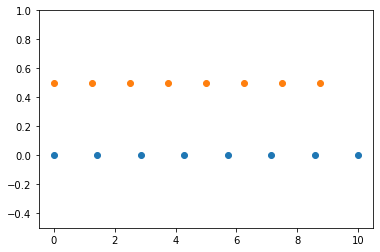

In [310]:
import matplotlib.pyplot as plt

N=8
y=np.zeros(N)
x1=np.linspace(0,10,N, endpoint=True)
x2=np.linspace(0,10,N, endpoint=False)
plt.plot(x1,y,'o')
plt.plot(x2,y+0.5, 'o')
plt.ylim([-0.5, 1])
plt.show()

###### numpy.logspace

 numpy.logspace(start, stop, num=50, endpoint=True, base=10.0, dtype=None, axis=0)[source]

    Return numbers spaced evenly on a log scale.

    In linear space, the sequence starts at base ** start (base to the power of start) and ends with base ** stop (see endpoint below).

    Changed in version 1.16.0: Non-scalar start and stop are now supported.

    Parameters

        startarray_like

            base ** start is the starting value of the sequence.
        stoparray_like

            base ** stop is the final value of the sequence, unless endpoint is False. In that case, num + 1 values are spaced over the interval in log-space, of which all but the last (a sequence of length num) are returned.
        numinteger, optional

            Number of samples to generate. Default is 50.
        endpointboolean, optional

            If true, stop is the last sample. Otherwise, it is not included. Default is True.
        basearray_like, optional

            The base of the log space. The step size between the elements in ln(samples) / ln(base) (or log_base(samples)) is uniform. Default is 10.0.
        dtypedtype

            The type of the output array. If dtype is not given, the data type is inferred from start and stop. The inferred type will never be an integer; float is chosen even if the arguments would produce an array of integers.
        axisint, optional

            The axis in the result to store the samples. Relevant only if start or stop are array-like. By default (0), the samples will be along a new axis inserted at the beginning. Use -1 to get an axis at the end.

            New in version 1.16.0.

    Returns

        samplesndarray

            num samples, equally spaced on a log scale.



In [312]:
y = np.logspace(2.0,3.0, num=4)
y

array([ 100.        ,  215.443469  ,  464.15888336, 1000.        ])

In [313]:
np.logspace(2.0,3.0, num=4, endpoint=False)

array([100.        , 177.827941  , 316.22776602, 562.34132519])

In [314]:
np.logspace(2.0,3.0, num=4, base=2.0)

array([4.        , 5.0396842 , 6.34960421, 8.        ])

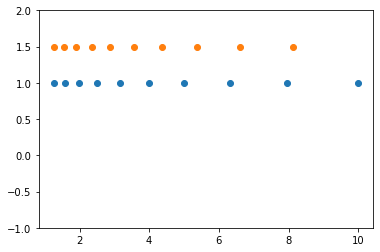

In [319]:
import matplotlib.pyplot as plt

N = 10
x1 = np.logspace(0.1, 1, N, endpoint=True)
x2 = np.logspace(0.1, 1, N, endpoint=False)
y = np.ones(N)
plt.plot(x1,y,'o')
plt.plot(x2, y+0.5, 'o')
plt.ylim([-1,2])
plt.show()

###### numpy.mgrid

numpy.mgrid = <numpy.lib.index_tricks.MGridClass object>

    nd_grid instance which returns a dense multi-dimensional “meshgrid”.

    An instance of numpy.lib.index_tricks.nd_grid which returns an dense (or fleshed out) mesh-grid when indexed, so that each returned argument has the same shape. The dimensions and number of the output arrays are equal to the number of indexing dimensions. If the step length is not a complex number, then the stop is not inclusive.

    However, if the step length is a complex number (e.g. 5j), then the integer part of its magnitude is interpreted as specifying the number of points to create between the start and stop values, where the stop value is inclusive.

    Returns

        mesh-grid ndarrays all of the same dimensions

In [320]:
np.mgrid[0:5, 0:5]

array([[[0, 0, 0, 0, 0],
        [1, 1, 1, 1, 1],
        [2, 2, 2, 2, 2],
        [3, 3, 3, 3, 3],
        [4, 4, 4, 4, 4]],

       [[0, 1, 2, 3, 4],
        [0, 1, 2, 3, 4],
        [0, 1, 2, 3, 4],
        [0, 1, 2, 3, 4],
        [0, 1, 2, 3, 4]]])

In [321]:
np.mgrid[-1:1:5j]

array([-1. , -0.5,  0. ,  0.5,  1. ])

###### numpy.ogrid

numpy.ogrid = <numpy.lib.index_tricks.OGridClass object>

    nd_grid instance which returns an open multi-dimensional “meshgrid”.

    An instance of numpy.lib.index_tricks.nd_grid which returns an open (i.e. not fleshed out) mesh-grid when indexed, so that only one dimension of each returned array is greater than 1. The dimension and number of the output arrays are equal to the number of indexing dimensions. If the step length is not a complex number, then the stop is not inclusive.

    However, if the step length is a complex number (e.g. 5j), then the integer part of its magnitude is interpreted as specifying the number of points to create between the start and stop values, where the stop value is inclusive.

    Returns

        mesh-grid

            ndarrays with only one dimension not equal to 1



In [322]:
np.ogrid[-1:1:5j]

array([-1. , -0.5,  0. ,  0.5,  1. ])

In [323]:
np.ogrid[0:5,0:5]

[array([[0],
        [1],
        [2],
        [3],
        [4]]),
 array([[0, 1, 2, 3, 4]])]

numpy.ones

numpy.ones(shape, dtype=None, order='C', *, like=None)[source]

    Return a new array of given shape and type, filled with ones.

    Parameters

        shapeint or sequence of ints

            Shape of the new array, e.g., (2, 3) or 2.
        dtypedata-type, optional

            The desired data-type for the array, e.g., numpy.int8. Default is numpy.float64.
        order{‘C’, ‘F’}, optional, default: C

            Whether to store multi-dimensional data in row-major (C-style) or column-major (Fortran-style) order in memory.
        likearray_like

            Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

            Note

            The like keyword is an experimental feature pending on acceptance of NEP 35.

            New in version 1.20.0.

    Returns

        outndarray

            Array of ones with the given shape, dtype, and order.



In [324]:
np.ones(5)

array([1., 1., 1., 1., 1.])

In [325]:
np.eye(5)

array([[1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.]])

In [327]:
np.ones((5,),dtype=int)

array([1, 1, 1, 1, 1])

In [328]:
np.ones((2,1))

array([[1.],
       [1.]])

In [329]:
s = (2,2)
np.ones(s)

array([[1., 1.],
       [1., 1.]])

###### numpy.ones_like

numpy.ones_like(a, dtype=None, order='K', subok=True, shape=None)[source]

    Return an array of ones with the same shape and type as a given array.

    Parameters

        aarray_like

            The shape and data-type of a define these same attributes of the returned array.
        dtypedata-type, optional

            Overrides the data type of the result.

            New in version 1.6.0.
        order{‘C’, ‘F’, ‘A’, or ‘K’}, optional

            Overrides the memory layout of the result. ‘C’ means C-order, ‘F’ means F-order, ‘A’ means ‘F’ if a is Fortran contiguous, ‘C’ otherwise. ‘K’ means match the layout of a as closely as possible.

            New in version 1.6.0.
        subokbool, optional.

            If True, then the newly created array will use the sub-class type of ‘a’, otherwise it will be a base-class array. Defaults to True.
        shapeint or sequence of ints, optional.

            Overrides the shape of the result. If order=’K’ and the number of dimensions is unchanged, will try to keep order, otherwise, order=’C’ is implied.

            New in version 1.17.0.

    Returns

        outndarray

            Array of ones with the same shape and type as a.



In [334]:
x = np.arange(16).reshape((4,4))
x

array([[ 0,  1,  2,  3],
       [ 4,  5,  6,  7],
       [ 8,  9, 10, 11],
       [12, 13, 14, 15]])

In [335]:
np.ones_like(x)

array([[1, 1, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 1]])

numpy.r_

numpy.r_ = <numpy.lib.index_tricks.RClass object>

    Translates slice objects to concatenation along the first axis.

    This is a simple way to build up arrays quickly. There are two use cases.

        If the index expression contains comma separated arrays, then stack them along their first axis.

        If the index expression contains slice notation or scalars then create a 1-D array with a range indicated by the slice notation.

    If slice notation is used, the syntax start:stop:step is equivalent to np.arange(start, stop, step) inside of the brackets. However, if step is an imaginary number (i.e. 100j) then its integer portion is interpreted as a number-of-points desired and the start and stop are inclusive. In other words start:stop:stepj is interpreted as np.linspace(start, stop, step, endpoint=1) inside of the brackets. After expansion of slice notation, all comma separated sequences are concatenated together.

    Optional character strings placed as the first element of the index expression can be used to change the output. The strings ‘r’ or ‘c’ result in matrix output. If the result is 1-D and ‘r’ is specified a 1 x N (row) matrix is produced. If the result is 1-D and ‘c’ is specified, then a N x 1 (column) matrix is produced. If the result is 2-D then both provide the same matrix result.

    A string integer specifies which axis to stack multiple comma separated arrays along. A string of two comma-separated integers allows indication of the minimum number of dimensions to force each entry into as the second integer (the axis to concatenate along is still the first integer).

    A string with three comma-separated integers allows specification of the axis to concatenate along, the minimum number of dimensions to force the entries to, and which axis should contain the start of the arrays which are less than the specified number of dimensions. In other words the third integer allows you to specify where the 1’s should be placed in the shape of the arrays that have their shapes upgraded. By default, they are placed in the front of the shape tuple. The third argument allows you to specify where the start of the array should be instead. Thus, a third argument of ‘0’ would place the 1’s at the end of the array shape. Negative integers specify where in the new shape tuple the last dimension of upgraded arrays should be placed, so the default is ‘-1’.

    Parameters

        Not a function, so takes no parameters

    Returns

        A concatenated ndarray or matrix.

In [336]:
np.r_[np.array([1,2,3]),0, 0, np.array([4,5,6])]

array([1, 2, 3, 0, 0, 4, 5, 6])

In [337]:
np.r_[-1:1:6j, [0]*3,5,6]

array([-1. , -0.6, -0.2,  0.2,  0.6,  1. ,  0. ,  0. ,  0. ,  5. ,  6. ])

String integers specify the axis to concatenate along or the minimum number of dimensions to force entries into

In [338]:
a = np.array([[0,1,2],[3,4,5]])
np.r_['-1',a,a] # concatenate along the last axis

array([[0, 1, 2, 0, 1, 2],
       [3, 4, 5, 3, 4, 5]])

In [339]:
np.r_['0,2',[1,2,3],[4,5,6]] #concatenate along first axis, dim>=2

array([[1, 2, 3],
       [4, 5, 6]])

In [340]:
np.r_[[1,2,3],[4,5,6]]

array([1, 2, 3, 4, 5, 6])

In [341]:
np.r_['0,2,0', [1,2,3], [4,5,6]]

array([[1],
       [2],
       [3],
       [4],
       [5],
       [6]])

In [342]:
np.r_['1,2,0', [1,2,3], [4,5,6]]

array([[1, 4],
       [2, 5],
       [3, 6]])

Using ‘r’ or ‘c’ as a first string argument creates a matrix.

In [343]:
np.r_['r',[1,2,3], [4,5,6]]

matrix([[1, 2, 3, 4, 5, 6]])

In [344]:
np.r_['c',[1,2,3], [4,5,6]]

matrix([[1],
        [2],
        [3],
        [4],
        [5],
        [6]])

###### numpy.zeros

 numpy.zeros(shape, dtype=float, order='C', *, like=None)

    Return a new array of given shape and type, filled with zeros.

    Parameters

        shapeint or tuple of ints

            Shape of the new array, e.g., (2, 3) or 2.
        dtypedata-type, optional

            The desired data-type for the array, e.g., numpy.int8. Default is numpy.float64.
        order{‘C’, ‘F’}, optional, default: ‘C’

            Whether to store multi-dimensional data in row-major (C-style) or column-major (Fortran-style) order in memory.
        likearray_like

            Reference object to allow the creation of arrays which are not NumPy arrays. If an array-like passed in as like supports the __array_function__ protocol, the result will be defined by it. In this case, it ensures the creation of an array object compatible with that passed in via this argument.

            Note

            The like keyword is an experimental feature pending on acceptance of NEP 35.

            New in version 1.20.0.

    Returns

        outndarray

            Array of zeros with the given shape, dtype, and order.



In [345]:
np.zeros(5)

array([0., 0., 0., 0., 0.])

In [346]:
np.zeros((5))

array([0., 0., 0., 0., 0.])

In [347]:
np.zeros((5,))

array([0., 0., 0., 0., 0.])

In [348]:
np.zeros((5,),dtype=int)

array([0, 0, 0, 0, 0])

In [350]:
np.zeros((2,1))

array([[0.],
       [0.]])

In [351]:
s = (2,2)
np.zeros(s)

array([[0., 0.],
       [0., 0.]])

In [352]:
np.zeros((2,),dtype=[('x', 'i4'),('y','i4')])

array([(0, 0), (0, 0)], dtype=[('x', '<i4'), ('y', '<i4')])

###### numpy.zeros_like

 numpy.zeros_like(a, dtype=None, order='K', subok=True, shape=None)[source]

    Return an array of zeros with the same shape and type as a given array.

    Parameters

        aarray_like

            The shape and data-type of a define these same attributes of the returned array.
        dtypedata-type, optional

            Overrides the data type of the result.

            New in version 1.6.0.
        order{‘C’, ‘F’, ‘A’, or ‘K’}, optional

            Overrides the memory layout of the result. ‘C’ means C-order, ‘F’ means F-order, ‘A’ means ‘F’ if a is Fortran contiguous, ‘C’ otherwise. ‘K’ means match the layout of a as closely as possible.

            New in version 1.6.0.
        subokbool, optional.

            If True, then the newly created array will use the sub-class type of ‘a’, otherwise it will be a base-class array. Defaults to True.
        shapeint or sequence of ints, optional.

            Overrides the shape of the result. If order=’K’ and the number of dimensions is unchanged, will try to keep order, otherwise, order=’C’ is implied.

            New in version 1.17.0.

    Returns

        outndarray

            Array of zeros with the same shape and type as a.



In [353]:
x = np.arange(6).reshape(2,3)
np.zeros_like(x)

array([[0, 0, 0],
       [0, 0, 0]])

In [354]:
y = np.arange(3, dtype=float)
np.zeros_like(y)

array([0., 0., 0.])

###### numpy.ndarray.astype

 ndarray.astype(dtype, order='K', casting='unsafe', subok=True, copy=True)

    Copy of the array, cast to a specified type.

    Parameters

        dtypestr or dtype

            Typecode or data-type to which the array is cast.
        order{‘C’, ‘F’, ‘A’, ‘K’}, optional

            Controls the memory layout order of the result. ‘C’ means C order, ‘F’ means Fortran order, ‘A’ means ‘F’ order if all the arrays are Fortran contiguous, ‘C’ order otherwise, and ‘K’ means as close to the order the array elements appear in memory as possible. Default is ‘K’.
        casting{‘no’, ‘equiv’, ‘safe’, ‘same_kind’, ‘unsafe’}, optional

            Controls what kind of data casting may occur. Defaults to ‘unsafe’ for backwards compatibility.

                    ‘no’ means the data types should not be cast at all.

                    ‘equiv’ means only byte-order changes are allowed.

                    ‘safe’ means only casts which can preserve values are allowed.

                    ‘same_kind’ means only safe casts or casts within a kind, like float64 to float32, are allowed.

                    ‘unsafe’ means any data conversions may be done.

        subokbool, optional

            If True, then sub-classes will be passed-through (default), otherwise the returned array will be forced to be a base-class array.
        copybool, optional

            By default, astype always returns a newly allocated array. If this is set to false, and the dtype, order, and subok requirements are satisfied, the input array is returned instead of a copy.

    Returns

        arr_tndarray

            Unless copy is False and the other conditions for returning the input array are satisfied (see description for copy input parameter), arr_t is a new array of the same shape as the input array, with dtype, order given by dtype, order.

    Raises

        ComplexWarning

            When casting from complex to float or int. To avoid this, one should use a.real.astype(t).



In [355]:
x = np.array([1,2,2.5])
x

array([1. , 2. , 2.5])

In [356]:
x.astype(int)

array([1, 2, 2])

In [357]:
x.astype(complex)

array([1. +0.j, 2. +0.j, 2.5+0.j])

In [358]:
x.astype(str)

array(['1.0', '2.0', '2.5'], dtype='<U32')

In [359]:
x.astype(float)

array([1. , 2. , 2.5])

###### numpy.atleast_1d

 numpy.atleast_1d(*arys)

    Convert inputs to arrays with at least one dimension.

    Scalar inputs are converted to 1-dimensional arrays, whilst higher-dimensional inputs are preserved.

    Parameters

        arys1, arys2, …array_like

            One or more input arrays.

    Returns

        retndarray

            An array, or list of arrays, each with a.ndim >= 1. Copies are made only if necessary.



In [360]:
np.atleast_1d(1.0)

array([1.])

In [361]:
x = np.arange(9.0).reshape(3,3)
np.atleast_1d(x)`

array([[0., 1., 2.],
       [3., 4., 5.],
       [6., 7., 8.]])

In [362]:
x

array([[0., 1., 2.],
       [3., 4., 5.],
       [6., 7., 8.]])

In [363]:
np.atleast_1d(1,[3,4])

[array([1]), array([3, 4])]

###### numpy.atleast_2d

 numpy.atleast_2d(*arys)[source]

    View inputs as arrays with at least two dimensions.

    Parameters

        arys1, arys2, …array_like

            One or more array-like sequences. Non-array inputs are converted to arrays. Arrays that already have two or more dimensions are preserved.

    Returns

        res, res2, …ndarray

            An array, or list of arrays, each with a.ndim >= 2. Copies are avoided where possible, and views with two or more dimensions are returned.



In [364]:
np.atleast_2d(3.0)

array([[3.]])

In [365]:
x = np.arange(3.0)
np.atleast_2d(x)

array([[0., 1., 2.]])

In [366]:
np.atleast_2d(x).base is x

True

In [367]:
np.atleast_2d(1,[1,2],[[1,2]])

[array([[1]]), array([[1, 2]]), array([[1, 2]])]

###### numpy.atleast_3d

 numpy.atleast_3d(*arys)[source]

    View inputs as arrays with at least three dimensions.

    Parameters

        arys1, arys2, …array_like

            One or more array-like sequences. Non-array inputs are converted to arrays. Arrays that already have three or more dimensions are preserved.

    Returns

        res1, res2, …ndarray

            An array, or list of arrays, each with a.ndim >= 3. Copies are avoided where possible, and views with three or more dimensions are returned. For example, a 1-D array of shape (N,) becomes a view of shape (1, N, 1), and a 2-D array of shape (M, N) becomes a view of shape (M, N, 1).



In [368]:
np.atleast_3d(3.0)

array([[[3.]]])

In [369]:
x = np.arange(3.0)
np.atleast_3d(x)

array([[[0.],
        [1.],
        [2.]]])

In [370]:
x = np.arange(12.0).reshape(4,3)
np.atleast_3d(x).shape

(4, 3, 1)

In [371]:
np.atleast_3d(x).base is x.base

True

In [372]:
x

array([[ 0.,  1.,  2.],
       [ 3.,  4.,  5.],
       [ 6.,  7.,  8.],
       [ 9., 10., 11.]])

In [373]:
for arr in np.atleast_3d([1, 2], [[1, 2]], [[[1, 2]]]):
    print(arr, arr.shape)

[[[1]
  [2]]] (1, 2, 1)
[[[1]
  [2]]] (1, 2, 1)
[[[1 2]]] (1, 1, 2)


###### numpy.mat

numpy.mat(data, dtype=None)[source]

    Interpret the input as a matrix.

    Unlike matrix, asmatrix does not make a copy if the input is already a matrix or an ndarray. Equivalent to matrix(data, copy=False).

    Parameters

        dataarray_like

            Input data.
        dtypedata-type

            Data-type of the output matrix.

    Returns

        matmatrix

            data interpreted as a matrix.



In [374]:
x = np.array([[1,2],[3,4]])
m = np.asmatrix(x)

In [375]:
m

matrix([[1, 2],
        [3, 4]])

In [376]:
x[0,0]=5

In [377]:
m

matrix([[5, 2],
        [3, 4]])

###### numpy.array_split

 numpy.array_split(ary, indices_or_sections, axis=0)[source]

    Split an array into multiple sub-arrays.

    Please refer to the split documentation. The only difference between these functions is that array_split allows indices_or_sections to be an integer that does not equally divide the axis. For an array of length l that should be split into n sections, it returns l % n sub-arrays of size l//n + 1 and the rest of size l//n.

In [379]:
x = np.arange(8.0)
np.array_split(x,3)

[array([0., 1., 2.]), array([3., 4., 5.]), array([6., 7.])]

In [380]:
x = np.arange(9)
np.array_split(x,4)

[array([0, 1, 2]), array([3, 4]), array([5, 6]), array([7, 8])]

###### numpy.column_stack

Stack 1-D arrays as columns into a 2-D array.

Take a sequence of 1-D arrays and stack them as columns to make a single 2-D array. 2-D arrays are stacked as-is, just like with hstack. 1-D arrays are turned into 2-D columns first.

Parameters

    tupsequence of 1-D or 2-D arrays.

        Arrays to stack. All of them must have the same first dimension.

Returns

    stacked2-D array

        The array formed by stacking the given arrays.



In [381]:
a = np.array((1,2,3))
b = np.array((2,3,4))
np.column_stack((a,b))

array([[1, 2],
       [2, 3],
       [3, 4]])

###### numpy.concatenate


 numpy.concatenate((a1, a2, ...), axis=0, out=None, dtype=None, casting="same_kind")

    Join a sequence of arrays along an existing axis.

    Parameters

        a1, a2, …sequence of array_like

            The arrays must have the same shape, except in the dimension corresponding to axis (the first, by default).
        axisint, optional

            The axis along which the arrays will be joined. If axis is None, arrays are flattened before use. Default is 0.
        outndarray, optional

            If provided, the destination to place the result. The shape must be correct, matching that of what concatenate would have returned if no out argument were specified.
        dtypestr or dtype

            If provided, the destination array will have this dtype. Cannot be provided together with out.

            ..versionadded:: 1.20.0
        casting{‘no’, ‘equiv’, ‘safe’, ‘same_kind’, ‘unsafe’}, optional

            Controls what kind of data casting may occur. Defaults to ‘same_kind’.

            ..versionadded:: 1.20.0

    Returns

        resndarray

            The concatenated array.



When one or more of the arrays to be concatenated is a MaskedArray, this function will return a MaskedArray object instead of an ndarray, but the input masks are not preserved. In cases where a MaskedArray is expected as input, use the ma.concatenate function from the masked array module instead.

In [383]:
a = np.array([[1,2],[3,4]])
b = np.array([[5,6]])

np.concatenate((a,b),axis=0)

array([[1, 2],
       [3, 4],
       [5, 6]])

In [385]:
np.concatenate((a, b.T), axis=1)

array([[1, 2, 5],
       [3, 4, 6]])

In [386]:
np.concatenate((a, b), axis=None)

array([1, 2, 3, 4, 5, 6])

This function will not preserve masking of MaskedArray inputs.

In [387]:
a = np.ma.arange(3)
a

masked_array(data=[0, 1, 2],
             mask=False,
       fill_value=999999)

In [389]:
a[1] = np.ma.masked

In [390]:
b = np.arange(2,5)

In [391]:
b

array([2, 3, 4])

In [392]:
np.concatenate([a,b])

masked_array(data=[0, 1, 2, 2, 3, 4],
             mask=False,
       fill_value=999999)

In [393]:
np.ma.concatenate([a, b])

masked_array(data=[0, --, 2, 2, 3, 4],
             mask=[False,  True, False, False, False, False],
       fill_value=999999)

###### numpy.diagonal

numpy.diagonal(a, offset=0, axis1=0, axis2=1)[source]

    Return specified diagonals.

    If a is 2-D, returns the diagonal of a with the given offset, i.e., the collection of elements of the form a[i, i+offset]. If a has more than two dimensions, then the axes specified by axis1 and axis2 are used to determine the 2-D sub-array whose diagonal is returned. The shape of the resulting array can be determined by removing axis1 and axis2 and appending an index to the right equal to the size of the resulting diagonals.

    In versions of NumPy prior to 1.7, this function always returned a new, independent array containing a copy of the values in the diagonal.

    In NumPy 1.7 and 1.8, it continues to return a copy of the diagonal, but depending on this fact is deprecated. Writing to the resulting array continues to work as it used to, but a FutureWarning is issued.

    Starting in NumPy 1.9 it returns a read-only view on the original array. Attempting to write to the resulting array will produce an error.

    In some future release, it will return a read/write view and writing to the returned array will alter your original array. The returned array will have the same type as the input array.

    If you don’t write to the array returned by this function, then you can just ignore all of the above.

    If you depend on the current behavior, then we suggest copying the returned array explicitly, i.e., use np.diagonal(a).copy() instead of just np.diagonal(a). This will work with both past and future versions of NumPy.

    Parameters

        aarray_like

            Array from which the diagonals are taken.
        offsetint, optional

            Offset of the diagonal from the main diagonal. Can be positive or negative. Defaults to main diagonal (0).
        axis1int, optional

            Axis to be used as the first axis of the 2-D sub-arrays from which the diagonals should be taken. Defaults to first axis (0).
        axis2int, optional

            Axis to be used as the second axis of the 2-D sub-arrays from which the diagonals should be taken. Defaults to second axis (1).

    Returns

        array_of_diagonalsndarray

            If a is 2-D, then a 1-D array containing the diagonal and of the same type as a is returned unless a is a matrix, in which case a 1-D array rather than a (2-D) matrix is returned in order to maintain backward compatibility.

            If a.ndim > 2, then the dimensions specified by axis1 and axis2 are removed, and a new axis inserted at the end corresponding to the diagonal.

    Raises

        ValueError

            If the dimension of a is less than 2.



In [394]:
a = np.arange(4).reshape(2,2)
a

array([[0, 1],
       [2, 3]])

In [396]:
a.diagonal()

array([0, 3])

In [397]:
a.diagonal(1)

array([1])

In [398]:
a.diagonal(2)

array([], dtype=int32)

In [399]:
a = np.arange(8).reshape(2,2,2); a

array([[[0, 1],
        [2, 3]],

       [[4, 5],
        [6, 7]]])

In [400]:
a.diagonal()

array([[0, 6],
       [1, 7]])

In [401]:
a.diagonal(0,0,1)

array([[0, 6],
       [1, 7]])

In [402]:
a.diagonal(0,1,0)

array([[0, 6],
       [1, 7]])

In [404]:
a.diagonal(1,1,0)

array([[4],
       [5]])

The anti-diagonal can be obtained by reversing the order of elements using either numpy.flipud or numpy.fliplr.

In [405]:
a = np.arange(9).reshape(3, 3)
a

array([[0, 1, 2],
       [3, 4, 5],
       [6, 7, 8]])

In [406]:
a.diagonal()

array([0, 4, 8])

In [407]:
np.fliplr(a).diagonal()

array([2, 4, 6])

In [408]:
np.flipud(a).diagonal()

array([6, 4, 2])

###### numpy.dsplit

 numpy.dsplit(ary, indices_or_sections)[source]

    Split array into multiple sub-arrays along the 3rd axis (depth).

    Please refer to the split documentation. dsplit is equivalent to split with axis=2, the array is always split along the third axis provided the array dimension is greater than or equal to 3.

In [409]:
x = np.arange(16).reshape(2,2,4)
x

array([[[ 0,  1,  2,  3],
        [ 4,  5,  6,  7]],

       [[ 8,  9, 10, 11],
        [12, 13, 14, 15]]])

In [410]:
np.dsplit(x,2)

[array([[[ 0,  1],
         [ 4,  5]],
 
        [[ 8,  9],
         [12, 13]]]),
 array([[[ 2,  3],
         [ 6,  7]],
 
        [[10, 11],
         [14, 15]]])]

In [411]:
np.dsplit(x, np.array([3, 6]))

[array([[[ 0,  1,  2],
         [ 4,  5,  6]],
 
        [[ 8,  9, 10],
         [12, 13, 14]]]),
 array([[[ 3],
         [ 7]],
 
        [[11],
         [15]]]),
 array([], shape=(2, 2, 0), dtype=int32)]

###### numpy.dstack

 numpy.dstack(tup)[source]

    Stack arrays in sequence depth wise (along third axis).

    This is equivalent to concatenation along the third axis after 2-D arrays of shape (M,N) have been reshaped to (M,N,1) and 1-D arrays of shape (N,) have been reshaped to (1,N,1). Rebuilds arrays divided by dsplit.

    This function makes most sense for arrays with up to 3 dimensions. For instance, for pixel-data with a height (first axis), width (second axis), and r/g/b channels (third axis). The functions concatenate, stack and block provide more general stacking and concatenation operations.

    Parameters

        tupsequence of arrays

            The arrays must have the same shape along all but the third axis. 1-D or 2-D arrays must have the same shape.

    Returns

        stackedndarray

            The array formed by stacking the given arrays, will be at least 3-D.



In [412]:
a = np.array((1,2,3))
b = np.array((2,3,4))
np.dstack((a,b))

array([[[1, 2],
        [2, 3],
        [3, 4]]])

In [413]:
a = np.array([[1],[2],[3]])
b = np.array([[2],[3],[4]])
np.dstack((a,b))

array([[[1, 2]],

       [[2, 3]],

       [[3, 4]]])

numpy.hsplit

numpy.hsplit(ary, indices_or_sections)

    Split an array into multiple sub-arrays horizontally (column-wise).

    Please refer to the split documentation. hsplit is equivalent to split with axis=1, the array is always split along the second axis regardless of the array dimension.

In [414]:
x = np.arange(16.0).reshape(4, 4)

In [415]:
np.hsplit(x, 2)

[array([[ 0.,  1.],
        [ 4.,  5.],
        [ 8.,  9.],
        [12., 13.]]),
 array([[ 2.,  3.],
        [ 6.,  7.],
        [10., 11.],
        [14., 15.]])]

In [416]:
np.hsplit(x, np.array([3, 6]))

[array([[ 0.,  1.,  2.],
        [ 4.,  5.,  6.],
        [ 8.,  9., 10.],
        [12., 13., 14.]]),
 array([[ 3.],
        [ 7.],
        [11.],
        [15.]]),
 array([], shape=(4, 0), dtype=float64)]

With a higher dimensional array the split is still along the second axis.

In [417]:
x = np.arange(8.0).reshape(2, 2, 2)

In [418]:
np.hsplit(x, 2)

[array([[[0., 1.]],
 
        [[4., 5.]]]),
 array([[[2., 3.]],
 
        [[6., 7.]]])]

numpy.hstack

numpy.hstack(tup)[source]

    Stack arrays in sequence horizontally (column wise).

    This is equivalent to concatenation along the second axis, except for 1-D arrays where it concatenates along the first axis. Rebuilds arrays divided by hsplit.

    This function makes most sense for arrays with up to 3 dimensions. For instance, for pixel-data with a height (first axis), width (second axis), and r/g/b channels (third axis). The functions concatenate, stack and block provide more general stacking and concatenation operations.

    Parameters

        tupsequence of ndarrays

            The arrays must have the same shape along all but the second axis, except 1-D arrays which can be any length.

    Returns

        stackedndarray

            The array formed by stacking the given arrays.



In [419]:
x = np.arange(16).reshape(4,4)
np.hstack(x)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15])

In [420]:
a = np.array([[1],[2],[3]])
b = np.array([[2],[3],[4]])

np.hstack((a,b))

array([[1, 2],
       [2, 3],
       [3, 4]])

###### numpy.ndarray.item

 ndarray.item(*args)

    Copy an element of an array to a standard Python scalar and return it.

    Parameters

        *argsArguments (variable number and type)

                none: in this case, the method only works for arrays with one element (a.size == 1), which element is copied into a standard Python scalar object and returned.

                int_type: this argument is interpreted as a flat index into the array, specifying which element to copy and return.

                tuple of int_types: functions as does a single int_type argument, except that the argument is interpreted as an nd-index into the array.

    Returns

        zStandard Python scalar object

            A copy of the specified element of the array as a suitable Python scalar



When the data type of a is longdouble or clongdouble, item() returns a scalar array object because there is no available Python scalar that would not lose information. Void arrays return a buffer object for item(), unless fields are defined, in which case a tuple is returned.

item is very similar to a[args], except, instead of an array scalar, a standard Python scalar is returned. This can be useful for speeding up access to elements of the array and doing arithmetic on elements of the array using Python’s optimized math.

In [461]:
np.random.seed(10)
x = np.random.randint(9, size=(3,3))
x

array([[4, 0, 1],
       [0, 1, 8],
       [0, 8, 6]])

In [462]:
x.item(3)

0

In [463]:
x.item(7)

8

In [464]:
x.item((0, 1))

0

In [468]:
x.item((2, 2))

6

In [469]:
x[2,2]

6

In [470]:
x[0,1]

0

###### numpy.ravel

Return a contiguous flattened array.

A 1-D array, containing the elements of the input, is returned. A copy is made only if needed.

As of NumPy 1.10, the returned array will have the same type as the input array. (for example, a masked array will be returned for a masked array input)

Parameters

    aarray_like

        Input array. The elements in a are read in the order specified by order, and packed as a 1-D array.
    order{‘C’,’F’, ‘A’, ‘K’}, optional

        The elements of a are read using this index order. ‘C’ means to index the elements in row-major, C-style order, with the last axis index changing fastest, back to the first axis index changing slowest. ‘F’ means to index the elements in column-major, Fortran-style order, with the first index changing fastest, and the last index changing slowest. Note that the ‘C’ and ‘F’ options take no account of the memory layout of the underlying array, and only refer to the order of axis indexing. ‘A’ means to read the elements in Fortran-like index order if a is Fortran contiguous in memory, C-like order otherwise. ‘K’ means to read the elements in the order they occur in memory, except for reversing the data when strides are negative. By default, ‘C’ index order is used.

Returns

    yarray_like

        y is an array of the same subtype as a, with shape (a.size,). Note that matrices are special cased for backward compatibility, if a is a matrix, then y is a 1-D ndarray.



Notes

In row-major, C-style order, in two dimensions, the row index varies the slowest, and the column index the quickest. This can be generalized to multiple dimensions, where row-major order implies that the index along the first axis varies slowest, and the index along the last quickest. The opposite holds for column-major, Fortran-style index ordering.

When a view is desired in as many cases as possible, arr.reshape(-1) may be preferable.

In [471]:
x = np.array([[1, 2, 3], [4, 5, 6]])
np.ravel(x)


array([1, 2, 3, 4, 5, 6])

In [472]:
x.reshape(-1)

array([1, 2, 3, 4, 5, 6])

In [473]:
np.ravel(x, order='F')

array([1, 4, 2, 5, 3, 6])

In [474]:
x.flatten()

array([1, 2, 3, 4, 5, 6])

When order is ‘A’, it will preserve the array’s ‘C’ or ‘F’ ordering:

In [475]:
np.ravel(x.T)

array([1, 4, 2, 5, 3, 6])

In [476]:
np.ravel(x.T, order='A')

array([1, 2, 3, 4, 5, 6])

When order is ‘K’, it will preserve orderings that are neither ‘C’ nor ‘F’, but won’t reverse axes

In [477]:
a = np.arange(3)[::-1]; a

array([2, 1, 0])

In [478]:
a.ravel(order='C')

array([2, 1, 0])

In [479]:
a.ravel(order='K')

array([2, 1, 0])

In [480]:
a = np.arange(12).reshape(2,3,2).swapaxes(1,2); a

array([[[ 0,  2,  4],
        [ 1,  3,  5]],

       [[ 6,  8, 10],
        [ 7,  9, 11]]])

In [481]:
a.ravel(order='C')

array([ 0,  2,  4,  1,  3,  5,  6,  8, 10,  7,  9, 11])

In [482]:
a.ravel(order='K')

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])

###### numpy.repeat

 numpy.repeat(a, repeats, axis=None)[source]

    Repeat elements of an array.

    Parameters

        aarray_like

            Input array.
        repeatsint or array of ints

            The number of repetitions for each element. repeats is broadcasted to fit the shape of the given axis.
        axisint, optional

            The axis along which to repeat values. By default, use the flattened input array, and return a flat output array.

    Returns

        repeated_arrayndarray

            Output array which has the same shape as a, except along the given axis.



In [483]:
np.repeat(3,4)

array([3, 3, 3, 3])

In [487]:
x = np.array([[1,2],[3,4]])

In [488]:
x = np.repeat(x,2)

In [489]:
x

array([1, 1, 2, 2, 3, 3, 4, 4])

In [491]:
np.repeat(x, 3)

array([1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4,
       4, 4])

###### numpy.reshape

 numpy.reshape(a, newshape, order='C')[source]

    Gives a new shape to an array without changing its data.

    Parameters

        aarray_like

            Array to be reshaped.
        newshapeint or tuple of ints

            The new shape should be compatible with the original shape. If an integer, then the result will be a 1-D array of that length. One shape dimension can be -1. In this case, the value is inferred from the length of the array and remaining dimensions.
        order{‘C’, ‘F’, ‘A’}, optional

            Read the elements of a using this index order, and place the elements into the reshaped array using this index order. ‘C’ means to read / write the elements using C-like index order, with the last axis index changing fastest, back to the first axis index changing slowest. ‘F’ means to read / write the elements using Fortran-like index order, with the first index changing fastest, and the last index changing slowest. Note that the ‘C’ and ‘F’ options take no account of the memory layout of the underlying array, and only refer to the order of indexing. ‘A’ means to read / write the elements in Fortran-like index order if a is Fortran contiguous in memory, C-like order otherwise.

    Returns

        reshaped_arrayndarray

            This will be a new view object if possible; otherwise, it will be a copy. Note there is no guarantee of the memory layout (C- or Fortran- contiguous) of the returned array.



In [494]:
a = np.zeros((10, 2))
a

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.]])

In [495]:
b = a.T
b

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [496]:
c = b.view()

In [498]:
c

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [500]:
c.reshape(5,4)

array([[0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.]])

In [502]:
a = np.arange(6).reshape((3, 2))
np.reshape(a, (2, 3))

array([[0, 1, 2],
       [3, 4, 5]])

In [503]:
np.reshape(np.ravel(a), (2, 3))

array([[0, 1, 2],
       [3, 4, 5]])

In [504]:
np.reshape(a, (2, 3), order='F')

array([[0, 4, 3],
       [2, 1, 5]])

In [505]:
a = np.array([[1,2,3], [4,5,6]])
np.reshape(a, 6)

array([1, 2, 3, 4, 5, 6])

In [506]:
np.reshape(a, (3,-1)) 

array([[1, 2],
       [3, 4],
       [5, 6]])

###### numpy.resize

 numpy.resize(a, new_shape)[source]

    Return a new array with the specified shape.

    If the new array is larger than the original array, then the new array is filled with repeated copies of a. Note that this behavior is different from a.resize(new_shape) which fills with zeros instead of repeated copies of a.

    Parameters

        aarray_like

            Array to be resized.
        new_shapeint or tuple of int

            Shape of resized array.

    Returns

        reshaped_arrayndarray

            The new array is formed from the data in the old array, repeated if necessary to fill out the required number of elements. The data are repeated in the order that they are stored in memory.



When the total size of the array does not change reshape should be used. In most other cases either indexing (to reduce the size) or padding (to increase the size) may be a more appropriate solution.

Warning: This functionality does not consider axes separately, i.e. it does not apply interpolation/extrapolation. It fills the return array with the required number of elements, taken from a as they are laid out in memory, disregarding strides and axes. (This is in case the new shape is smaller. For larger, see above.) This functionality is therefore not suitable to resize images, or data where each axis represents a separate and distinct entity.

In [507]:
a=np.array([[0,1],[2,3]])

In [508]:
a

array([[0, 1],
       [2, 3]])

In [509]:
np.resize(a,(2,3))

array([[0, 1, 2],
       [3, 0, 1]])

In [510]:
np.resize(a,(1,4))

array([[0, 1, 2, 3]])

In [511]:
np.resize(a,(2,4))

array([[0, 1, 2, 3],
       [0, 1, 2, 3]])

###### numpy.squeeze

###### numpy.squeeze(a, axis=None)[source]

    Remove axes of length one from a.

    Parameters

        aarray_like

            Input data.
        axisNone or int or tuple of ints, optional

            New in version 1.7.0.

            Selects a subset of the entries of length one in the shape. If an axis is selected with shape entry greater than one, an error is raised.

    Returns

        squeezedndarray

            The input array, but with all or a subset of the dimensions of length 1 removed. This is always a itself or a view into a. Note that if all axes are squeezed, the result is a 0d array and not a scalar.

    Raises

        ValueError

            If axis is not None, and an axis being squeezed is not of length 1



In [512]:
x = np.array([[[0], [1], [2]]])
x.shape

(1, 3, 1)

In [513]:
np.squeeze(x).shape

(3,)

In [514]:
np.squeeze(x, axis=0).shape

(3, 1)

In [515]:
np.squeeze(x, axis=1).shape

ValueError: cannot select an axis to squeeze out which has size not equal to one

In [516]:
np.squeeze(x, axis=2).shape

(1, 3)

In [517]:
x = np.array([[1234]])

In [518]:
x.shape

(1, 1)

In [519]:
np.squeeze(x)

array(1234)

In [520]:
np.squeeze(x).shape

()

In [521]:
np.squeeze(x)[()]

1234

###### numpy.swapaxes

 numpy.swapaxes(a, axis1, axis2)[source]

    Interchange two axes of an array.

    Parameters

        aarray_like

            Input array.
        axis1int

            First axis.
        axis2int

            Second axis.

    Returns

        a_swappedndarray

            For NumPy >= 1.10.0, if a is an ndarray, then a view of a is returned; otherwise a new array is created. For earlier NumPy versions a view of a is returned only if the order of the axes is changed, otherwise the input array is returned.



In [522]:
x = np.array([[1,2,3]])

np.swapaxes(x,0,1)

array([[1],
       [2],
       [3]])

In [524]:
x = np.array([[[0,1],[2,3]],[[4,5],[6,7]]])
x

array([[[0, 1],
        [2, 3]],

       [[4, 5],
        [6, 7]]])

In [525]:
np.swapaxes(x,0,2)

array([[[0, 4],
        [2, 6]],

       [[1, 5],
        [3, 7]]])

###### numpy.take

 numpy.take(a, indices, axis=None, out=None, mode='raise')[source]

    Take elements from an array along an axis.

    When axis is not None, this function does the same thing as “fancy” indexing (indexing arrays using arrays); however, it can be easier to use if you need elements along a given axis. A call such as np.take(arr, indices, axis=3) is equivalent to arr[:,:,:,indices,...].

    Explained without fancy indexing, this is equivalent to the following use of ndindex, which sets each of ii, jj, and kk to a tuple of indices:

    Ni, Nk = a.shape[:axis], a.shape[axis+1:]
    Nj = indices.shape
    for ii in ndindex(Ni):
        for jj in ndindex(Nj):
            for kk in ndindex(Nk):
                out[ii + jj + kk] = a[ii + (indices[jj],) + kk]

    Parameters

        aarray_like (Ni…, M, Nk…)

            The source array.
        indicesarray_like (Nj…)

            The indices of the values to extract.

            New in version 1.8.0.

            Also allow scalars for indices.
        axisint, optional

            The axis over which to select values. By default, the flattened input array is used.
        outndarray, optional (Ni…, Nj…, Nk…)

            If provided, the result will be placed in this array. It should be of the appropriate shape and dtype. Note that out is always buffered if mode=’raise’; use other modes for better performance.
        mode{‘raise’, ‘wrap’, ‘clip’}, optional

            Specifies how out-of-bounds indices will behave.

                ‘raise’ – raise an error (default)

                ‘wrap’ – wrap around

                ‘clip’ – clip to the range

            ‘clip’ mode means that all indices that are too large are replaced by the index that addresses the last element along that axis. Note that this disables indexing with negative numbers.

    Returns

        outndarray (Ni…, Nj…, Nk…)

            The returned array has the same type as a

In [527]:
a = [4, 3, 5, 7, 6, 8]
indices = [0, 1, 4]
a

[4, 3, 5, 7, 6, 8]

In [528]:
np.take(a, indices)

array([4, 3, 6])

In [529]:
a = np.array(a)
a[indices]

array([4, 3, 6])

In [530]:
np.take(a, [[0, 1], [2, 3]])

array([[4, 3],
       [5, 7]])

In [533]:
b = np.random.random(16).reshape(4,4)
np.take(b, [0,3,7,8])

array([0.68535982, 0.51219226, 0.29187607, 0.91777412])

In [534]:
b

array([[0.68535982, 0.95339335, 0.00394827, 0.51219226],
       [0.81262096, 0.61252607, 0.72175532, 0.29187607],
       [0.91777412, 0.71457578, 0.54254437, 0.14217005],
       [0.37334076, 0.67413362, 0.44183317, 0.43401399]])

###### numpy.transpose

umpy.transpose(a, axes=None)[source]

    Reverse or permute the axes of an array; returns the modified array.

    For an array a with two axes, transpose(a) gives the matrix transpose.

    Parameters

        aarray_like

            Input array.
        axestuple or list of ints, optional

            If specified, it must be a tuple or list which contains a permutation of [0,1,..,N-1] where N is the number of axes of a. The i’th axis of the returned array will correspond to the axis numbered axes[i] of the input. If not specified, defaults to range(a.ndim)[::-1], which reverses the order of the axes.

    Returns

        pndarray

            a with its axes permuted. A view is returned whenever possible.



In [535]:
x = np.arange(4).reshape((2,2))
np.transpose(x)

array([[0, 2],
       [1, 3]])

In [536]:
np.transpose(x).shape

(2, 2)

In [539]:
np.transpose(x, (1, 0))

array([[0, 2],
       [1, 3]])

###### numpy.vsplit

 numpy.vsplit(ary, indices_or_sections)

    Split an array into multiple sub-arrays vertically (row-wise).

    Please refer to the split documentation. vsplit is equivalent to split with axis=0 (default), the array is always split along the first axis regardless of the array dimension.

In [540]:
x = np.arange(16.0).reshape(4, 4)

np.vsplit(x, 2)

[array([[0., 1., 2., 3.],
        [4., 5., 6., 7.]]),
 array([[ 8.,  9., 10., 11.],
        [12., 13., 14., 15.]])]

In [541]:
np.vsplit(x, np.array([3, 6]))

[array([[ 0.,  1.,  2.,  3.],
        [ 4.,  5.,  6.,  7.],
        [ 8.,  9., 10., 11.]]),
 array([[12., 13., 14., 15.]]),
 array([], shape=(0, 4), dtype=float64)]

In [543]:
np.vsplit(x, 4)

[array([[0., 1., 2., 3.]]),
 array([[4., 5., 6., 7.]]),
 array([[ 8.,  9., 10., 11.]]),
 array([[12., 13., 14., 15.]])]

###### numpy.vstack

 numpy.vstack(tup)

    Stack arrays in sequence vertically (row wise).

    This is equivalent to concatenation along the first axis after 1-D arrays of shape (N,) have been reshaped to (1,N). Rebuilds arrays divided by vsplit.

    This function makes most sense for arrays with up to 3 dimensions. For instance, for pixel-data with a height (first axis), width (second axis), and r/g/b channels (third axis). The functions concatenate, stack and block provide more general stacking and concatenation operations.

    Parameters

        tupsequence of ndarrays

            The arrays must have the same shape along all but the first axis. 1-D arrays must have the same length.

    Returns

        stackedndarray

            The array formed by stacking the given arrays, will be at least 2-D.



In [544]:
a = np.array([1, 2, 3])
b = np.array([2, 3, 4])
np.vstack((a,b))

array([[1, 2, 3],
       [2, 3, 4]])

In [545]:
np.hstack((a,b))

array([1, 2, 3, 2, 3, 4])

###### numpy.all

 numpy.all(a, axis=None, out=None, keepdims=<no value>)[source]

    Test whether all array elements along a given axis evaluate to True.

    Parameters

        aarray_like

            Input array or object that can be converted to an array.
        axisNone or int or tuple of ints, optional

            Axis or axes along which a logical AND reduction is performed. The default (axis=None) is to perform a logical AND over all the dimensions of the input array. axis may be negative, in which case it counts from the last to the first axis.

            New in version 1.7.0.

            If this is a tuple of ints, a reduction is performed on multiple axes, instead of a single axis or all the axes as before.
        outndarray, optional

            Alternate output array in which to place the result. It must have the same shape as the expected output and its type is preserved (e.g., if dtype(out) is float, the result will consist of 0.0’s and 1.0’s). See ufuncs-output-type for more details.
        keepdimsbool, optional

            If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

            If the default value is passed, then keepdims will not be passed through to the all method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.

    Returns

        allndarray, bool

            A new boolean or array is returned unless out is specified, in which case a reference to out is returned.



In [546]:
np.all([[True,False],[True,True]])

False

In [547]:
np.all([[True,False],[True,True]], axis=0)

array([ True, False])

In [548]:
np.all([-1, 4, 5])

True

In [549]:
np.all([1.0, np.nan])

True

In [550]:
o=np.array(False)

In [551]:
z=np.all([-1, 4, 5], out=o)

In [552]:
id(z), id(o), z

(2766028650816, 2766028650816, array(True))

###### numpy.any

 numpy.any(a, axis=None, out=None, keepdims=<no value>)[source]

    Test whether any array element along a given axis evaluates to True.

    Returns single boolean unless axis is not None

    Parameters

        aarray_like

            Input array or object that can be converted to an array.
        axisNone or int or tuple of ints, optional

            Axis or axes along which a logical OR reduction is performed. The default (axis=None) is to perform a logical OR over all the dimensions of the input array. axis may be negative, in which case it counts from the last to the first axis.

            New in version 1.7.0.

            If this is a tuple of ints, a reduction is performed on multiple axes, instead of a single axis or all the axes as before.
        outndarray, optional

            Alternate output array in which to place the result. It must have the same shape as the expected output and its type is preserved (e.g., if it is of type float, then it will remain so, returning 1.0 for True and 0.0 for False, regardless of the type of a). See ufuncs-output-type for more details.
        keepdimsbool, optional

            If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

            If the default value is passed, then keepdims will not be passed through to the any method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.

    Returns

        anybool or ndarray

            A new boolean or ndarray is returned unless out is specified, in which case a reference to out is returned.



In [553]:
np.any([[True, False], [True, True]])

True

In [554]:
np.any([[True, False], [False, False]], axis=0)

array([ True, False])

In [555]:
np.any([-1, 0, 5])

True

In [556]:
np.any(np.nan)

True

###### numpy.where

numpy.where(condition[, x, y])

    Return elements chosen from x or y depending on condition.

    Note

    When only condition is provided, this function is a shorthand for np.asarray(condition).nonzero(). Using nonzero directly should be preferred, as it behaves correctly for subclasses. The rest of this documentation covers only the case where all three arguments are provided.

    Parameters

        conditionarray_like, bool

            Where True, yield x, otherwise yield y.
        x, yarray_like

            Values from which to choose. x, y and condition need to be broadcastable to some shape.

    Returns

        outndarray

            An array with elements from x where condition is True, and elements from y elsewhere.



In [557]:
a = np.arange(10)
a

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [559]:
np.where(a < 5, a, 10*a)

array([ 0,  1,  2,  3,  4, 50, 60, 70, 80, 90])

In [560]:
np.where(a>5)

(array([6, 7, 8, 9], dtype=int64),)

In [562]:
np.where(a==5, a, a*10)

array([ 0, 10, 20, 30, 40,  5, 60, 70, 80, 90])

In [563]:
np.where([[True, False], [True, True]],

         [[1, 2], [3, 4]],

         [[9, 8], [7, 6]])

array([[1, 8],
       [3, 4]])

In [564]:
x, y = np.ogrid[:3, :4]
np.where(x < y, x, 10 + y) 

array([[10,  0,  0,  0],
       [10, 11,  1,  1],
       [10, 11, 12,  2]])

###### numpy.argmax

 numpy.argmax(a, axis=None, out=None)[source]

    Returns the indices of the maximum values along an axis.

    Parameters

        aarray_like

            Input array.
        axisint, optional

            By default, the index is into the flattened array, otherwise along the specified axis.
        outarray, optional

            If provided, the result will be inserted into this array. It should be of the appropriate shape and dtype.

    Returns

        index_arrayndarray of ints

            Array of indices into the array. It has the same shape as a.shape with the dimension along axis removed.



In [574]:
a = np.arange(6).reshape(2,3) + 10
a

array([[10, 11, 12],
       [13, 14, 15]])

In [575]:
np.argmax(a)

5

In [576]:
np.argmax(a, axis=0)

array([1, 1, 1], dtype=int64)

In [577]:
np.argmax(a, axis=1)

array([2, 2], dtype=int64)

Indexes of the maximal elements of a N-dimensional array:

In [578]:
ind = np.unravel_index(np.argmax(a, axis=None), a.shape)
ind

(1, 2)

In [579]:
a[ind]

15

In [580]:
x = np.array([[4,2,3], [1,0,3]])

index_array = np.argmax(x, axis=-1)

In [581]:
np.take_along_axis(x, np.expand_dims(index_array, axis=-1), axis=-1)

array([[4],
       [3]])

###### numpy.argmin

 numpy.argmin(a, axis=None, out=None)[source]

    Returns the indices of the minimum values along an axis.

    Parameters

        aarray_like

            Input array.
        axisint, optional

            By default, the index is into the flattened array, otherwise along the specified axis.
        outarray, optional

            If provided, the result will be inserted into this array. It should be of the appropriate shape and dtype.

    Returns

        index_arrayndarray of ints

            Array of indices into the array. It has the same shape as a.shape with the dimension along axis removed.



In [582]:
a = np.arange(6).reshape(2,3)+10

In [583]:
a

array([[10, 11, 12],
       [13, 14, 15]])

In [584]:
np.argmin(a)

0

In [585]:
np.argmin(a, axis=0)

array([0, 0, 0], dtype=int64)

In [586]:
np.argmax(a, axis=1)

array([2, 2], dtype=int64)

In [589]:
a

array([[10, 11, 12],
       [13, 14, 15]])

In [590]:
a[0][0]

10

Indices of the minimum elements of a N-dimensional array:

In [591]:
ind = np.unravel_index(np.argmin(a, axis=None), a.shape)
ind

(0, 0)

In [592]:
a[ind]

10

In [593]:
b = np.arange(6) + 10
b

array([10, 11, 12, 13, 14, 15])

In [594]:
b[4]

14

In [595]:
np.argmin(b)

0

In [597]:
x = np.array([[4,2,3],[1,0,3]])
index_array = np.argmin(x, axis=-1)
np.take_along_axis(x, np.expand_dims(index_array, axis=-1), axis=-1)

array([[2],
       [0]])

In [599]:
np.take_along_axis(x, np.expand_dims(index_array, axis=-1), axis=-1).squeeze(axis=-1)

array([2, 0])

###### numpy.argsort

 numpy.argsort(a, axis=-1, kind=None, order=None)[source]

    Returns the indices that would sort an array.

    Perform an indirect sort along the given axis using the algorithm specified by the kind keyword. It returns an array of indices of the same shape as a that index data along the given axis in sorted order.

    Parameters

        aarray_like

            Array to sort.
        axisint or None, optional

            Axis along which to sort. The default is -1 (the last axis). If None, the flattened array is used.
        kind{‘quicksort’, ‘mergesort’, ‘heapsort’, ‘stable’}, optional

            Sorting algorithm. The default is ‘quicksort’. Note that both ‘stable’ and ‘mergesort’ use timsort under the covers and, in general, the actual implementation will vary with data type. The ‘mergesort’ option is retained for backwards compatibility.

            Changed in version 1.15.0.: The ‘stable’ option was added.
        orderstr or list of str, optional

            When a is an array with fields defined, this argument specifies which fields to compare first, second, etc. A single field can be specified as a string, and not all fields need be specified, but unspecified fields will still be used, in the order in which they come up in the dtype, to break ties.

    Returns

        index_arrayndarray, int

            Array of indices that sort a along the specified axis. If a is one-dimensional, a[index_array] yields a sorted a. More generally, np.take_along_axis(a, index_array, axis=axis) always yields the sorted a, irrespective of dimensionality.



In [600]:
x = np.array([3,1,2])
np.argsort(x)

array([1, 2, 0], dtype=int64)

In [601]:
x = np.array([[0,3],[2,2]])
x

array([[0, 3],
       [2, 2]])

In [602]:
np.argsort(x)

array([[0, 1],
       [0, 1]], dtype=int64)

In [603]:
np.argsort(x, axis=0) # sorts along first axis (down)

array([[0, 1],
       [1, 0]], dtype=int64)

In [604]:
np.take_along_axis(x, np.argsort(x, axis=0), axis=0) # same as np.sort(x, axis=0)

array([[0, 2],
       [2, 3]])

In [606]:
ind = np.argsort(x, axis=1)  # sorts along last axis (across)

In [607]:
ind

array([[0, 1],
       [0, 1]], dtype=int64)

In [608]:
np.take_along_axis(x, ind, axis=1) # same as np.sort(x, axis=1)

array([[0, 3],
       [2, 2]])

Indices of the sorted elements of a N-dimensional array:

In [610]:
ind = np.unravel_index(np.argsort(x, axis=None), x.shape)
ind

(array([0, 1, 1, 0], dtype=int64), array([0, 0, 1, 1], dtype=int64))

Sorting with keys:

In [611]:
x = np.array([(1, 0), (0, 1)], dtype=[('x', '<i4'), ('y', '<i4')])
x

array([(1, 0), (0, 1)], dtype=[('x', '<i4'), ('y', '<i4')])

In [612]:
np.argsort(x, order=('x','y'))

array([1, 0], dtype=int64)

In [613]:
np.argsort(x, order=('y','x'))

array([0, 1], dtype=int64)

###### numpy.ptp

numpy.ptp(a, axis=None, out=None, keepdims=<no value>)[source]

    Range of values (maximum - minimum) along an axis.

    The name of the function comes from the acronym for ‘peak to peak’.


Parameters

    aarray_like

        Input values.
    axisNone or int or tuple of ints, optional

        Axis along which to find the peaks. By default, flatten the array. axis may be negative, in which case it counts from the last to the first axis.

        New in version 1.15.0.

        If this is a tuple of ints, a reduction is performed on multiple axes, instead of a single axis or all the axes as before.
    outarray_like

        Alternative output array in which to place the result. It must have the same shape and buffer length as the expected output, but the type of the output values will be cast if necessary.
    keepdimsbool, optional

        If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

        If the default value is passed, then keepdims will not be passed through to the ptp method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.

Returns

    ptpndarray

        A new array holding the result, unless out was specified, in which case a reference to out is returned.



In [614]:
x = np.array([[4, 9, 2, 10],

              [6, 9, 7, 12]])

In [615]:
np.ptp(x, axis=1)

array([8, 6])

In [616]:
np.ptp(x, axis=0)

array([2, 0, 5, 2])

In [617]:
np.ptp(x)

10

This example shows that a negative value can be returned when the input is an array of signed integers.

In [618]:
y = np.array([[1, 127],

              [0, 127],

              [-1, 127],

              [-2, 127]], dtype=np.int8)

In [619]:
np.ptp(y, axis=1)

array([ 126,  127, -128, -127], dtype=int8)

A work-around is to use the view() method to view the result as unsigned integers with the same bit width:

In [620]:
np.ptp(y, axis=1).view(np.uint8)

array([126, 127, 128, 129], dtype=uint8)

###### numpy.searchsorted

numpy.searchsorted(a, v, side='left', sorter=None)[source]

    Find indices where elements should be inserted to maintain order.

    Find the indices into a sorted array a such that, if the corresponding elements in v were inserted before the indices, the order of a would be preserved.

    Assuming that a is sorted:

    side
    	

    returned index i satisfies

    left
    	

    a[i-1] < v <= a[i]

    right
    	

    a[i-1] <= v < a[i]

    Parameters

        a1-D array_like

            Input array. If sorter is None, then it must be sorted in ascending order, otherwise sorter must be an array of indices that sort it.
        varray_like

            Values to insert into a.
        side{‘left’, ‘right’}, optional

            If ‘left’, the index of the first suitable location found is given. If ‘right’, return the last such index. If there is no suitable index, return either 0 or N (where N is the length of a).
        sorter1-D array_like, optional

            Optional array of integer indices that sort array a into ascending order. They are typically the result of argsort.

            New in version 1.7.0.

    Returns

        indicesarray of ints

            Array of insertion points with the same shape as v.



Binary search is used to find the required insertion points.

As of NumPy 1.4.0 searchsorted works with real/complex arrays containing nan values. The enhanced sort order is documented in sort.

This function uses the same algorithm as the builtin python bisect.bisect_left (side='left') and bisect.bisect_right (side='right') functions, which is also vectorized in the v argument.

In [621]:
np.searchsorted([1,2,3,4,5],3)

2

In [622]:
np.searchsorted([1,2,3,4,5], 3, side='right')

3

In [623]:
np.searchsorted([1,2,3,4,5], [-10, 10, 2, 3])

array([0, 5, 1, 2], dtype=int64)

###### numpy.sort

 numpy.sort(a, axis=-1, kind=None, order=None)[source]

    Return a sorted copy of an array.

    Parameters

        aarray_like

            Array to be sorted.
        axisint or None, optional

            Axis along which to sort. If None, the array is flattened before sorting. The default is -1, which sorts along the last axis.
        kind{‘quicksort’, ‘mergesort’, ‘heapsort’, ‘stable’}, optional

            Sorting algorithm. The default is ‘quicksort’. Note that both ‘stable’ and ‘mergesort’ use timsort or radix sort under the covers and, in general, the actual implementation will vary with data type. The ‘mergesort’ option is retained for backwards compatibility.

            Changed in version 1.15.0.: The ‘stable’ option was added.
        orderstr or list of str, optional

            When a is an array with fields defined, this argument specifies which fields to compare first, second, etc. A single field can be specified as a string, and not all fields need be specified, but unspecified fields will still be used, in the order in which they come up in the dtype, to break ties.

    Returns

        sorted_arrayndarray

            Array of the same type and shape as a.



The various sorting algorithms are characterized by their average speed, worst case performance, work space size, and whether they are stable. A stable sort keeps items with the same key in the same relative order. The four algorithms implemented in NumPy have the following properties:

kind         speed    worst case    work space    stable

‘quicksort’    1      O(n^2)         0            no

‘heapsort’     3     O(n*log(n))     0            no

‘mergesort’    2     O(n*log(n))     ~n/2         yes

‘timsort’      2     O(n*log(n))    ~n/2          yes

All the sort algorithms make temporary copies of the data when sorting along any but the last axis. Consequently, sorting along the last axis is faster and uses less space than sorting along any other axis.

The sort order for complex numbers is lexicographic. If both the real and imaginary parts are non-nan then the order is determined by the real parts except when they are equal, in which case the order is determined by the imaginary parts.

Previous to numpy 1.4.0 sorting real and complex arrays containing nan values led to undefined behaviour. In numpy versions >= 1.4.0 nan values are sorted to the end. The extended sort order is:

        Real: [R, nan]

        Complex: [R + Rj, R + nanj, nan + Rj, nan + nanj]

where R is a non-nan real value. Complex values with the same nan placements are sorted according to the non-nan part if it exists. Non-nan values are sorted as before.

New in version 1.12.0.

quicksort has been changed to introsort. When sorting does not make enough progress it switches to heapsort. This implementation makes quicksort O(n*log(n)) in the worst case.

‘stable’ automatically chooses the best stable sorting algorithm for the data type being sorted. It, along with ‘mergesort’ is currently mapped to timsort or radix sort depending on the data type. API forward compatibility currently limits the ability to select the implementation and it is hardwired for the different data types.

New in version 1.17.0.

Timsort is added for better performance on already or nearly sorted data. On random data timsort is almost identical to mergesort. It is now used for stable sort while quicksort is still the default sort if none is chosen. For timsort details, refer to CPython listsort.txt. ‘mergesort’ and ‘stable’ are mapped to radix sort for integer data types. Radix sort is an O(n) sort instead of O(n log n).

Changed in version 1.18.0.

NaT now sorts to the end of arrays for consistency with NaN.

In [626]:
a = np.array([[1,4],[3,1]])
np.sort(a)   # sort along the last axis

array([[1, 4],
       [1, 3]])

In [627]:
np.sort(a, axis=None)  # sort the flattened array

array([1, 1, 3, 4])

In [628]:
np.sort(a, axis=0)   # sort along the first axis

array([[1, 1],
       [3, 4]])

Use the order keyword to specify a field to use when sorting a structured array:

In [629]:
dtype = [('name', 'S10'), ('height', float), ('age', int)]

In [630]:
values = [('Arthur', 1.8, 41), ('Lancelot', 1.9, 38),

          ('Galahad', 1.7, 38)]

In [631]:
a = np.array(values, dtype=dtype)       # create a structured array

In [632]:
a

array([(b'Arthur', 1.8, 41), (b'Lancelot', 1.9, 38),
       (b'Galahad', 1.7, 38)],
      dtype=[('name', 'S10'), ('height', '<f8'), ('age', '<i4')])

In [633]:
np.sort(a, order='height')

array([(b'Galahad', 1.7, 38), (b'Arthur', 1.8, 41),
       (b'Lancelot', 1.9, 38)],
      dtype=[('name', 'S10'), ('height', '<f8'), ('age', '<i4')])

Sort by age, then height if ages are equal:

In [634]:
np.sort(a, order=['age', 'height'])    

array([(b'Galahad', 1.7, 38), (b'Lancelot', 1.9, 38),
       (b'Arthur', 1.8, 41)],
      dtype=[('name', 'S10'), ('height', '<f8'), ('age', '<i4')])

###### numpy.choose

 numpy.choose(a, choices, out=None, mode='raise')[source]

    Construct an array from an index array and a set of arrays to choose from.

    First of all, if confused or uncertain, definitely look at the Examples - in its full generality, this function is less simple than it might seem from the following code description (below ndi = numpy.lib.index_tricks):

    np.choose(a,c) == np.array([c[a[I]][I] for I in ndi.ndindex(a.shape)]).

    But this omits some subtleties. Here is a fully general summary:

    Given an “index” array (a) of integers and a sequence of n arrays (choices), a and each choice array are first broadcast, as necessary, to arrays of a common shape; calling these Ba and Bchoices[i], i = 0,…,n-1 we have that, necessarily, Ba.shape == Bchoices[i].shape for each i. Then, a new array with shape Ba.shape is created as follows:

        if mode=raise (the default), then, first of all, each element of a (and thus Ba) must be in the range [0, n-1]; now, suppose that i (in that range) is the value at the (j0, j1, …, jm) position in Ba - then the value at the same position in the new array is the value in Bchoices[i] at that same position;

        if mode=wrap, values in a (and thus Ba) may be any (signed) integer; modular arithmetic is used to map integers outside the range [0, n-1] back into that range; and then the new array is constructed as above;

        if mode=clip, values in a (and thus Ba) may be any (signed) integer; negative integers are mapped to 0; values greater than n-1 are mapped to n-1; and then the new array is constructed as above.

    Parameters

        aint array

            This array must contain integers in [0, n-1], where n is the number of choices, unless mode=wrap or mode=clip, in which cases any integers are permissible.
        choicessequence of arrays

            Choice arrays. a and all of the choices must be broadcastable to the same shape. If choices is itself an array (not recommended), then its outermost dimension (i.e., the one corresponding to choices.shape[0]) is taken as defining the “sequence”.
        outarray, optional

            If provided, the result will be inserted into this array. It should be of the appropriate shape and dtype. Note that out is always buffered if mode=’raise’; use other modes for better performance.
        mode{‘raise’ (default), ‘wrap’, ‘clip’}, optional

            Specifies how indices outside [0, n-1] will be treated:

                    ‘raise’ : an exception is raised

                    ‘wrap’ : value becomes value mod n

                    ‘clip’ : values < 0 are mapped to 0, values > n-1 are mapped to n-1

    Returns

        merged_arrayarray

            The merged result.

    Raises

        ValueError: shape mismatch

            If a and each choice array are not all broadcastable to the same shape.



To reduce the chance of misinterpretation, even though the following “abuse” is nominally supported, choices should neither be, nor be thought of as, a single array, i.e., the outermost sequence-like container should be either a list or a tuple.

In [636]:
choices = [[0, 1, 2, 3], [10, 11, 12, 13],

  [20, 21, 22, 23], [30, 31, 32, 33]]

In [637]:
np.choose([2, 3, 1, 0], choices)

array([20, 31, 12,  3])

the first element of the result will be the first element of the
third (2+1) "array" in choices, namely, 20; the second element
will be the second element of the fourth (3+1) choice array, i.e., 31, etc.

In [638]:
np.choose([2, 3, 1, 0], choices)

array([20, 31, 12,  3])

In [639]:
np.choose([2, 4, 1, 0], choices, mode='clip') # 4 goes to 3 (4-1)

array([20, 31, 12,  3])

In [640]:
np.choose([2, 4, 1, 0], choices, mode='wrap') # 4 goes to (4 mod 4)

array([20,  1, 12,  3])

In [641]:
a = [[1, 0, 1], [0, 1, 0], [1, 0, 1]]
choices = [-10, 10]
np.choose(a, choices)

array([[ 10, -10,  10],
       [-10,  10, -10],
       [ 10, -10,  10]])

In [642]:
a = np.array([0, 1]).reshape((2,1,1))
c1 = np.array([1, 2, 3]).reshape((1,3,1))
c2 = np.array([-1, -2, -3, -4, -5]).reshape((1,1,5))
np.choose(a, (c1, c2)) # result is 2x3x5, res[0,:,:]=c1, res[1,:,:]=c2

array([[[ 1,  1,  1,  1,  1],
        [ 2,  2,  2,  2,  2],
        [ 3,  3,  3,  3,  3]],

       [[-1, -2, -3, -4, -5],
        [-1, -2, -3, -4, -5],
        [-1, -2, -3, -4, -5]]])

###### numpy.compress

 numpy.compress(condition, a, axis=None, out=None)[source]

    Return selected slices of an array along given axis.

    When working along a given axis, a slice along that axis is returned in output for each index where condition evaluates to True. When working on a 1-D array, compress is equivalent to extract.

    Parameters

        condition1-D array of bools

            Array that selects which entries to return. If len(condition) is less than the size of a along the given axis, then output is truncated to the length of the condition array.
        aarray_like

            Array from which to extract a part.
        axisint, optional

            Axis along which to take slices. If None (default), work on the flattened array.
        outndarray, optional

            Output array. Its type is preserved and it must be of the right shape to hold the output.

    Returns

        compressed_arrayndarray

            A copy of a without the slices along axis for which condition is false.



In [643]:
a = np.array([[1, 2], [3, 4], [5, 6]])
a

array([[1, 2],
       [3, 4],
       [5, 6]])

In [644]:
np.compress([0, 1], a, axis=0)

array([[3, 4]])

In [645]:
np.compress([False, True, True], a, axis=0)

array([[3, 4],
       [5, 6]])

In [646]:
np.compress([False, True], a, axis=1)

array([[2],
       [4],
       [6]])

###### numpy.cumprod

 numpy.cumprod(a, axis=None, dtype=None, out=None)[source]

    Return the cumulative product of elements along a given axis.

    Parameters

        aarray_like

            Input array.
        axisint, optional

            Axis along which the cumulative product is computed. By default the input is flattened.
        dtypedtype, optional

            Type of the returned array, as well as of the accumulator in which the elements are multiplied. If dtype is not specified, it defaults to the dtype of a, unless a has an integer dtype with a precision less than that of the default platform integer. In that case, the default platform integer is used instead.
        outndarray, optional

            Alternative output array in which to place the result. It must have the same shape and buffer length as the expected output but the type of the resulting values will be cast if necessary.

    Returns

        cumprodndarray

            A new array holding the result is returned unless out is specified, in which case a reference to out is returned.



In [647]:
a = np.array([1,2,3])
np.cumprod(a) # intermediate results 1, 1*2

              # total product 1*2*3 = 6

array([1, 2, 6], dtype=int32)

In [648]:
a = np.array([[1, 2, 3], [4, 5, 6]])
np.cumprod(a, dtype=float)

array([  1.,   2.,   6.,  24., 120., 720.])

In [649]:
np.cumprod(a, axis=0)

array([[ 1,  2,  3],
       [ 4, 10, 18]], dtype=int32)

The cumulative product for each row (i.e. over the columns) of a:

In [650]:
np.cumprod(a,axis=1)

array([[  1,   2,   6],
       [  4,  20, 120]], dtype=int32)

###### numpy.cumsum

 numpy.cumsum(a, axis=None, dtype=None, out=None)[source]

    Return the cumulative sum of the elements along a given axis.

    Parameters

        aarray_like

            Input array.
        axisint, optional

            Axis along which the cumulative sum is computed. The default (None) is to compute the cumsum over the flattened array.
        dtypedtype, optional

            Type of the returned array and of the accumulator in which the elements are summed. If dtype is not specified, it defaults to the dtype of a, unless a has an integer dtype with a precision less than that of the default platform integer. In that case, the default platform integer is used.
        outndarray, optional

            Alternative output array in which to place the result. It must have the same shape and buffer length as the expected output but the type will be cast if necessary. See ufuncs-output-type for more details.

    Returns

        cumsum_along_axisndarray.

            A new array holding the result is returned unless out is specified, in which case a reference to out is returned. The result has the same size as a, and the same shape as a if axis is not None or a is a 1-d array.



In [651]:
a = np.array([[1,2,3], [4,5,6]])
a

array([[1, 2, 3],
       [4, 5, 6]])

In [652]:
np.cumsum(a)

array([ 1,  3,  6, 10, 15, 21], dtype=int32)

In [653]:
np.cumsum(a,axis=0)

array([[1, 2, 3],
       [5, 7, 9]], dtype=int32)

In [654]:
np.cumsum(a,axis=1)

array([[ 1,  3,  6],
       [ 4,  9, 15]], dtype=int32)

##### numpy.inner

 numpy.inner(a, b)

    Inner product of two arrays.

    Ordinary inner product of vectors for 1-D arrays (without complex conjugation), in higher dimensions a sum product over the last axes.

    Parameters

        a, barray_like

            If a and b are nonscalar, their last dimensions must match.

    Returns

        outndarray

            out.shape = a.shape[:-1] + b.shape[:-1]

    Raises

        ValueError

            If the last dimension of a and b has different size.



For vectors (1-D arrays) it computes the ordinary inner-product:

np.inner(a, b) = sum(a[:]*b[:])

More generally, if ndim(a) = r > 0 and ndim(b) = s > 0:

np.inner(a, b) = np.tensordot(a, b, axes=(-1,-1))

or explicitly:

np.inner(a, b)[i0,...,ir-1,j0,...,js-1]
     = sum(a[i0,...,ir-1,:]*b[j0,...,js-1,:])

In addition a or b may be scalars, in which case:

In [657]:
a = np.array([1,2,3])
b = np.array([0,1,0])
a

array([1, 2, 3])

In [658]:
b

array([0, 1, 0])

In [659]:
np.inner(a, b)

2

In [660]:
a = np.arange(24).reshape((2,3,4))
b = np.arange(4)
np.inner(a, b)

array([[ 14,  38,  62],
       [ 86, 110, 134]])

In [661]:
a

array([[[ 0,  1,  2,  3],
        [ 4,  5,  6,  7],
        [ 8,  9, 10, 11]],

       [[12, 13, 14, 15],
        [16, 17, 18, 19],
        [20, 21, 22, 23]]])

In [662]:
b

array([0, 1, 2, 3])

An example where b is a scalar:

In [663]:
np.inner(np.eye(2), 7)

array([[7., 0.],
       [0., 7.]])

###### numpy.ndarray.fill

method

ndarray.fill(value)

    Fill the array with a scalar value.

    Parameters

        valuescalar

            All elements of a will be assigned this value.



In [664]:
a = np.array([1, 2])
a.fill(0)
a

array([0, 0])

In [665]:
a = np.empty(2)

In [666]:
a.fill(1)

In [667]:
a

array([1., 1.])

In [674]:
a = np.empty(8)

In [675]:
a

array([ 8.,  9., 10., 11., 12., 13., 14., 15.])

In [676]:
a.fill(5)

In [677]:
a

array([5., 5., 5., 5., 5., 5., 5., 5.])

###### numpy.imag

numpy.imag(val)[source]

    Return the imaginary part of the complex argument.

    Parameters

        valarray_like

            Input array.

    Returns

        outndarray or scalar

            The imaginary component of the complex argument. If val is real, the type of val is used for the output. If val has complex elements, the returned type is float.



In [678]:
a = np.array([1+2j, 3+4j, 5+6j])

In [679]:
a.imag

array([2., 4., 6.])

In [680]:
a.imag = np.array([8, 10, 12])
a

array([1. +8.j, 3.+10.j, 5.+12.j])

In [681]:
np.imag(1 + 1j)

1.0

###### numpy.prod

numpy.prod(a, axis=None, dtype=None, out=None, keepdims=<no value>, initial=<no value>, where=<no value>)[source]

    Return the product of array elements over a given axis.

    Parameters

        aarray_like

            Input data.
        axisNone or int or tuple of ints, optional

            Axis or axes along which a product is performed. The default, axis=None, will calculate the product of all the elements in the input array. If axis is negative it counts from the last to the first axis.

            New in version 1.7.0.

            If axis is a tuple of ints, a product is performed on all of the axes specified in the tuple instead of a single axis or all the axes as before.
        dtypedtype, optional

            The type of the returned array, as well as of the accumulator in which the elements are multiplied. The dtype of a is used by default unless a has an integer dtype of less precision than the default platform integer. In that case, if a is signed then the platform integer is used while if a is unsigned then an unsigned integer of the same precision as the platform integer is used.
        outndarray, optional

            Alternative output array in which to place the result. It must have the same shape as the expected output, but the type of the output values will be cast if necessary.
        keepdimsbool, optional

            If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

            If the default value is passed, then keepdims will not be passed through to the prod method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.
        initialscalar, optional

            The starting value for this product. See reduce for details.

            New in version 1.15.0.
        wherearray_like of bool, optional

            Elements to include in the product. See reduce for details.

            New in version 1.17.0.

    Returns

        product_along_axisndarray, see dtype parameter above.

            An array shaped as a but with the specified axis removed. Returns a reference to out if specified.



In [682]:
x = np.array([536870910, 536870910, 536870910, 536870910])
np.prod(x)

16

In [683]:
np.prod([]) #The product of an empty array is the neutral element 1:

1.0

In [684]:
np.prod([1.,2.])

2.0

Even when the input array is two-dimensional:

In [685]:
np.prod([[1.,2.],[3.,4.]])

24.0

But we can also specify the axis over which to multiply:

In [686]:
np.prod([[1.,2.],[3.,4.]], axis=1)

array([ 2., 12.])

Or select specific elements to include:

In [687]:
np.prod([1., np.nan, 3.], where=[True, False, True])

3.0

If the type of x is unsigned, then the output type is the unsigned platform integer:

In [688]:
x = np.array([1, 2, 3], dtype=np.uint8)
np.prod(x).dtype == np.uint

True

If x is of a signed integer type, then the output type is the default platform integer:

In [689]:
x = np.array([1, 2, 3], dtype=np.int8)
np.prod(x).dtype == int

True

In [690]:
np.prod([1, 2], initial=5)

10

###### numpy.put

numpy.put(a, ind, v, mode='raise')[source]

    Replaces specified elements of an array with given values.

    The indexing works on the flattened target array. put is roughly equivalent to:

    a.flat[ind] = v

    Parameters

        andarray

            Target array.
        indarray_like

            Target indices, interpreted as integers.
        varray_like

            Values to place in a at target indices. If v is shorter than ind it will be repeated as necessary.
        mode{‘raise’, ‘wrap’, ‘clip’}, optional

            Specifies how out-of-bounds indices will behave.

                ‘raise’ – raise an error (default)

                ‘wrap’ – wrap around

                ‘clip’ – clip to the range

            ‘clip’ mode means that all indices that are too large are replaced by the index that addresses the last element along that axis. Note that this disables indexing with negative numbers. In ‘raise’ mode, if an exception occurs the target array may still be modified.



In [691]:
a = np.arange(5)
a

array([0, 1, 2, 3, 4])

In [692]:
np.put(a, [0, 2], [-44, -55])

In [693]:
a

array([-44,   1, -55,   3,   4])

In [694]:
a = np.arange(5)
np.put(a, 22, -5, mode='clip')

In [695]:
a

array([ 0,  1,  2,  3, -5])

###### numpy.putmask

 numpy.putmask(a, mask, values)

    Changes elements of an array based on conditional and input values.

    Sets a.flat[n] = values[n] for each n where mask.flat[n]==True.

    If values is not the same size as a and mask then it will repeat. This gives behavior different from a[mask] = values.

    Parameters

        aarray_like

            Target array.
        maskarray_like

            Boolean mask array. It has to be the same shape as a.
        valuesarray_like

            Values to put into a where mask is True. If values is smaller than a it will be repeated.



In [696]:
x = np.arange(6).reshape(2, 3)
np.putmask(x, x>2, x**2)
x

array([[ 0,  1,  2],
       [ 9, 16, 25]])

If values is smaller than a it is repeated:

In [697]:
x = np.arange(5)
np.putmask(x, x>1, [-33, -44])
x

array([  0,   1, -33, -44, -33])

###### numpy.real

numpy.real(val)

    Return the real part of the complex argument.

    Parameters

        valarray_like

            Input array.

    Returns

        outndarray or scalar

            The real component of the complex argument. If val is real, the type of val is used for the output. If val has complex elements, the returned type is float.



In [698]:
a = np.array([1+2j, 3+4j, 5+6j])

In [699]:
a.real

array([1., 3., 5.])

In [700]:
a.real = 9

In [701]:
a

array([9.+2.j, 9.+4.j, 9.+6.j])

In [702]:
a.real = np.array([9, 8, 7])

In [703]:
a

array([9.+2.j, 8.+4.j, 7.+6.j])

###### numpy.cov

 numpy.cov(m, y=None, rowvar=True, bias=False, ddof=None, fweights=None, aweights=None)[source]

    Estimate a covariance matrix, given data and weights.

    Covariance indicates the level to which two variables vary together. If we examine N-dimensional samples, X = [x_1, x_2, ... x_N]^T, then the covariance matrix element C_{ij} is the covariance of x_i and x_j. The element C_{ii} is the variance of x_i.

    See the notes for an outline of the algorithm.

    Parameters

        marray_like

            A 1-D or 2-D array containing multiple variables and observations. Each row of m represents a variable, and each column a single observation of all those variables. Also see rowvar below.
        yarray_like, optional

            An additional set of variables and observations. y has the same form as that of m.
        rowvarbool, optional

            If rowvar is True (default), then each row represents a variable, with observations in the columns. Otherwise, the relationship is transposed: each column represents a variable, while the rows contain observations.
        biasbool, optional

            Default normalization (False) is by (N - 1), where N is the number of observations given (unbiased estimate). If bias is True, then normalization is by N. These values can be overridden by using the keyword ddof in numpy versions >= 1.5.
        ddofint, optional

            If not None the default value implied by bias is overridden. Note that ddof=1 will return the unbiased estimate, even if both fweights and aweights are specified, and ddof=0 will return the simple average. See the notes for the details. The default value is None.

            New in version 1.5.
        fweightsarray_like, int, optional

            1-D array of integer frequency weights; the number of times each observation vector should be repeated.

            New in version 1.10.
        aweightsarray_like, optional

            1-D array of observation vector weights. These relative weights are typically large for observations considered “important” and smaller for observations considered less “important”. If ddof=0 the array of weights can be used to assign probabilities to observation vectors.

            New in version 1.10.

    Returns

        outndarray

            The covariance matrix of the variables.



In [704]:
m = np.arange(10, dtype=np.float64)
f = np.arange(10) * 2
a = np.arange(10) ** 2.

ddof = 1

w = f * a

v1 = np.sum(w)
v2 = np.sum(w * a)

m -= np.sum(m * w, axis=None, keepdims=True) / v1

cov = np.dot(m * w, m.T) * v1 / (v1**2 - ddof * v2)

In [705]:
cov

2.368621947484198

In [706]:
x = [-2.1, -1,  4.3]

y = [3,  1.1,  0.12]

X = np.stack((x, y), axis=0)

np.cov(X)

array([[11.71      , -4.286     ],
       [-4.286     ,  2.14413333]])

In [708]:
a = np.zeros((2, 512*512), dtype=np.float32)
a[0, :] = 1.0
a[1, :] = 0.1
np.mean(a)

0.54999924

In [709]:
np.mean(a, dtype=np.float64)

0.5500000007450581

numpy.std

numpy.std(a, axis=None, dtype=None, out=None, ddof=0, keepdims=<no value>)[source]

    Compute the standard deviation along the specified axis.

    Returns the standard deviation, a measure of the spread of a distribution, of the array elements. The standard deviation is computed for the flattened array by default, otherwise over the specified axis.

    Parameters

        aarray_like

            Calculate the standard deviation of these values.
        axisNone or int or tuple of ints, optional

            Axis or axes along which the standard deviation is computed. The default is to compute the standard deviation of the flattened array.

            New in version 1.7.0.

            If this is a tuple of ints, a standard deviation is performed over multiple axes, instead of a single axis or all the axes as before.
        dtypedtype, optional

            Type to use in computing the standard deviation. For arrays of integer type the default is float64, for arrays of float types it is the same as the array type.
        outndarray, optional

            Alternative output array in which to place the result. It must have the same shape as the expected output but the type (of the calculated values) will be cast if necessary.
        ddofint, optional

            Means Delta Degrees of Freedom. The divisor used in calculations is N - ddof, where N represents the number of elements. By default ddof is zero.
        keepdimsbool, optional

            If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

            If the default value is passed, then keepdims will not be passed through to the std method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.

    Returns

        standard_deviationndarray, see dtype parameter above.

            If out is None, return a new array containing the standard deviation, otherwise return a reference to the output array.



The standard deviation is the square root of the average of the squared deviations from the mean, i.e., std = sqrt(mean(x)), where x = abs(a - a.mean())**2.

The average squared deviation is typically calculated as x.sum() / N, where N = len(x). If, however, ddof is specified, the divisor N - ddof is used instead. In standard statistical practice, ddof=1 provides an unbiased estimator of the variance of the infinite population. ddof=0 provides a maximum likelihood estimate of the variance for normally distributed variables. The standard deviation computed in this function is the square root of the estimated variance, so even with ddof=1, it will not be an unbiased estimate of the standard deviation per se.

Note that, for complex numbers, std takes the absolute value before squaring, so that the result is always real and nonnegative.

For floating-point input, the std is computed using the same precision the input has. Depending on the input data, this can cause the results to be inaccurate, especially for float32 (see example below). Specifying a higher-accuracy accumulator using the dtype keyword can alleviate this issue.

In [710]:
a = np.array([[1, 2], [3, 4]])
np.std(a)

1.118033988749895

In [711]:
np.std(a, axis=0)

array([1., 1.])

In [712]:
np.std(a, axis=1)

array([0.5, 0.5])

In [713]:
np.std(a, dtype=np.float64)

1.118033988749895

###### numpy.var

numpy.var(a, axis=None, dtype=None, out=None, ddof=0, keepdims=<no value>)[source]

    Compute the variance along the specified axis.

    Returns the variance of the array elements, a measure of the spread of a distribution. The variance is computed for the flattened array by default, otherwise over the specified axis.

    Parameters

        aarray_like

            Array containing numbers whose variance is desired. If a is not an array, a conversion is attempted.
        axisNone or int or tuple of ints, optional

            Axis or axes along which the variance is computed. The default is to compute the variance of the flattened array.

            New in version 1.7.0.

            If this is a tuple of ints, a variance is performed over multiple axes, instead of a single axis or all the axes as before.
        dtypedata-type, optional

            Type to use in computing the variance. For arrays of integer type the default is float64; for arrays of float types it is the same as the array type.
        outndarray, optional

            Alternate output array in which to place the result. It must have the same shape as the expected output, but the type is cast if necessary.
        ddofint, optional

            “Delta Degrees of Freedom”: the divisor used in the calculation is N - ddof, where N represents the number of elements. By default ddof is zero.
        keepdimsbool, optional

            If this is set to True, the axes which are reduced are left in the result as dimensions with size one. With this option, the result will broadcast correctly against the input array.

            If the default value is passed, then keepdims will not be passed through to the var method of sub-classes of ndarray, however any non-default value will be. If the sub-class’ method does not implement keepdims any exceptions will be raised.

    Returns

        variancendarray, see dtype parameter above

            If out=None, returns a new array containing the variance; otherwise, a reference to the output array is returned.

    See also

    std, mean, nanmean, nanstd, nanvar
    ufuncs-output-type

    Notes

    The variance is the average of the squared deviations from the mean, i.e., var = mean(x), where x = abs(a - a.mean())**2.

    The mean is typically calculated as x.sum() / N, where N = len(x). If, however, ddof is specified, the divisor N - ddof is used instead. In standard statistical practice, ddof=1 provides an unbiased estimator of the variance of a hypothetical infinite population. ddof=0 provides a maximum likelihood estimate of the variance for normally distributed variables.

    Note that for complex numbers, the absolute value is taken before squaring, so that the result is always real and nonnegative.

    For floating-point input, the variance is computed using the same precision the input has. Depending on the input data, this can cause the results to be inaccurate, especially for float32 (see example below). Specifying a higher-accuracy accumulator using the dtype keyword can alleviate this issue.

In [714]:
a = np.array([[1, 2], [3, 4]])

np.var(a)

1.25

In [715]:
np.var(a, axis=0)

array([1., 1.])

In [716]:
np.var(a, axis=1)

array([0.25, 0.25])

In [718]:
np.var(a, dtype=np.float64)

1.25

###### numpy.cross

numpy.cross(a, b, axisa=-1, axisb=-1, axisc=-1, axis=None)[source]

    Return the cross product of two (arrays of) vectors.

    The cross product of a and b in R^3 is a vector perpendicular to both a and b. If a and b are arrays of vectors, the vectors are defined by the last axis of a and b by default, and these axes can have dimensions 2 or 3. Where the dimension of either a or b is 2, the third component of the input vector is assumed to be zero and the cross product calculated accordingly. In cases where both input vectors have dimension 2, the z-component of the cross product is returned.

    Parameters

        aarray_like

            Components of the first vector(s).
        barray_like

            Components of the second vector(s).
        axisaint, optional

            Axis of a that defines the vector(s). By default, the last axis.
        axisbint, optional

            Axis of b that defines the vector(s). By default, the last axis.
        axiscint, optional

            Axis of c containing the cross product vector(s). Ignored if both input vectors have dimension 2, as the return is scalar. By default, the last axis.
        axisint, optional

            If defined, the axis of a, b and c that defines the vector(s) and cross product(s). Overrides axisa, axisb and axisc.

    Returns

        cndarray

            Vector cross product(s).

    Raises

        ValueError

            When the dimension of the vector(s) in a and/or b does not equal 2 or 3.



In [719]:
x = [1, 2, 3]

y = [4, 5, 6]

np.cross(x, y)

array([-3,  6, -3])

In [720]:
x = [1, 2]

y = [4, 5, 6]

np.cross(x, y)

array([12, -6, -3])

In [721]:
x = np.array([[1,2,3], [4,5,6]])

y = np.array([[4,5,6], [1,2,3]])

np.cross(x, y)

array([[-3,  6, -3],
       [ 3, -6,  3]])

The orientation of c can be changed using the axisc keyword.

In [722]:
np.cross(x, y, axisc=0)

array([[-3,  3],
       [ 6, -6],
       [-3,  3]])

Change the vector definition of x and y using axisa and axisb.

In [723]:
x = np.array([[1,2,3], [4,5,6], [7, 8, 9]])

y = np.array([[7, 8, 9], [4,5,6], [1,2,3]])

np.cross(x, y)

array([[ -6,  12,  -6],
       [  0,   0,   0],
       [  6, -12,   6]])

###### numpy.dot

numpy.dot(a, b, out=None)

    Dot product of two arrays. Specifically,

        If both a and b are 1-D arrays, it is inner product of vectors (without complex conjugation).

        If both a and b are 2-D arrays, it is matrix multiplication, but using matmul or a @ b is preferred.

        If either a or b is 0-D (scalar), it is equivalent to multiply and using numpy.multiply(a, b) or a * b is preferred.

        If a is an N-D array and b is a 1-D array, it is a sum product over the last axis of a and b.

        If a is an N-D array and b is an M-D array (where M>=2), it is a sum product over the last axis of a and the second-to-last axis of b:

        dot(a, b)[i,j,k,m] = sum(a[i,j,:] * b[k,:,m])

    Parameters

        aarray_like

            First argument.
        barray_like

            Second argument.
        outndarray, optional

            Output argument. This must have the exact kind that would be returned if it was not used. In particular, it must have the right type, must be C-contiguous, and its dtype must be the dtype that would be returned for dot(a,b). This is a performance feature. Therefore, if these conditions are not met, an exception is raised, instead of attempting to be flexible.

    Returns

        outputndarray

            Returns the dot product of a and b. If a and b are both scalars or both 1-D arrays then a scalar is returned; otherwise an array is returned. If out is given, then it is returned.

    Raises

        ValueError

            If the last dimension of a is not the same size as the second-to-last dimension of b.



In [724]:
np.dot(3, 4)

12

In [725]:
np.dot([2j, 3j], [2j, 3j])

(-13+0j)

In [726]:
a = [[1, 0], [0, 1]]

b = [[4, 1], [2, 2]]

np.dot(a, b)

array([[4, 1],
       [2, 2]])

In [727]:
a = np.arange(3*4*5*6).reshape((3,4,5,6))

b = np.arange(3*4*5*6)[::-1].reshape((5,4,6,3))

np.dot(a, b)[2,3,2,1,2,2]

499128

###### numpy.outer

numpy.outer(a, b, out=None)[source]

    Compute the outer product of two vectors.

    Given two vectors, a = [a0, a1, ..., aM] and b = [b0, b1, ..., bN], the outer product [1] is:

    [[a0*b0  a0*b1 ... a0*bN ]
     [a1*b0    .
     [ ...          .
     [aM*b0            aM*bN ]]

    Parameters

        a(M,) array_like

            First input vector. Input is flattened if not already 1-dimensional.
        b(N,) array_like

            Second input vector. Input is flattened if not already 1-dimensional.
        out(M, N) ndarray, optional

            A location where the result is stored

            New in version 1.9.0.

    Returns

        out(M, N) ndarray

            out[i, j] = a[i] * b[j]



In [728]:
x = np.array(['a', 'b', 'c'], dtype=object)
np.outer(x, [1, 2, 3])

array([['a', 'aa', 'aaa'],
       ['b', 'bb', 'bbb'],
       ['c', 'cc', 'ccc']], dtype=object)

###### numpy.linalg.svd

numpy.linalg.svd(a, full_matrices=True, compute_uv=True, hermitian=False)[source]

    Singular Value Decomposition.

    When a is a 2D array, it is factorized as u @ np.diag(s) @ vh = (u * s) @ vh, where u and vh are 2D unitary arrays and s is a 1D array of a’s singular values. When a is higher-dimensional, SVD is applied in stacked mode as explained below.

    Parameters

        a(…, M, N) array_like

            A real or complex array with a.ndim >= 2.
        full_matricesbool, optional

            If True (default), u and vh have the shapes (..., M, M) and (..., N, N), respectively. Otherwise, the shapes are (..., M, K) and (..., K, N), respectively, where K = min(M, N).
        compute_uvbool, optional

            Whether or not to compute u and vh in addition to s. True by default.
        hermitianbool, optional

            If True, a is assumed to be Hermitian (symmetric if real-valued), enabling a more efficient method for finding singular values. Defaults to False.

            New in version 1.17.0.

    Returns

        u{ (…, M, M), (…, M, K) } array

            Unitary array(s). The first a.ndim - 2 dimensions have the same size as those of the input a. The size of the last two dimensions depends on the value of full_matrices. Only returned when compute_uv is True.
        s(…, K) array

            Vector(s) with the singular values, within each vector sorted in descending order. The first a.ndim - 2 dimensions have the same size as those of the input a.
        vh{ (…, N, N), (…, K, N) } array

            Unitary array(s). The first a.ndim - 2 dimensions have the same size as those of the input a. The size of the last two dimensions depends on the value of full_matrices. Only returned when compute_uv is True.

    Raises

        LinAlgError

            If SVD computation does not converge.

    See also

    scipy.linalg.svd

        Similar function in SciPy.
    scipy.linalg.svdvals

        Compute singular values of a matrix.

    Notes

    Changed in version 1.8.0: Broadcasting rules apply, see the numpy.linalg documentation for details.

    The decomposition is performed using LAPACK routine _gesdd.

    SVD is usually described for the factorization of a 2D matrix A. The higher-dimensional case will be discussed below. In the 2D case, SVD is written as A = U S V^H, where A = a, U= u, S= \mathtt{np.diag}(s) and V^H = vh. The 1D array s contains the singular values of a and u and vh are unitary. The rows of vh are the eigenvectors of A^H A and the columns of u are the eigenvectors of A A^H. In both cases the corresponding (possibly non-zero) eigenvalues are given by s**2.

    If a has more than two dimensions, then broadcasting rules apply, as explained in Linear algebra on several matrices at once. This means that SVD is working in “stacked” mode: it iterates over all indices of the first a.ndim - 2 dimensions and for each combination SVD is applied to the last two indices. The matrix a can be reconstructed from the decomposition with either (u * s[..., None, :]) @ vh or u @ (s[..., None] * vh). (The @ operator can be replaced by the function np.matmul for python versions below 3.5.)

    If a is a matrix object (as opposed to an ndarray), then so are all the return values.

In [729]:
a = np.random.randn(9, 6) + 1j*np.random.randn(9, 6)

b = np.random.randn(2, 7, 8, 3) + 1j*np.random.randn(2, 7, 8, 3)

In [730]:
a

array([[ 0.26607016-1.50832149j,  2.38496733+0.62060066j,
         1.12369125-1.04513254j,  1.67262221-0.79800882j,
         0.09914922+1.98508459j,  1.39799638+1.74481415j],
       [-0.27124799-1.85618548j,  0.61320418-0.2227737j ,
        -0.26731719-0.06584785j, -0.54930901-2.13171211j,
         0.1327083 -0.04883051j, -0.47614201+0.39334122j],
       [ 1.30847308+0.21726515j,  0.19501328-1.99439377j,
         0.40020999+1.10770823j, -0.33763234+0.24454398j,
         1.25647226-0.06191203j, -0.7319695 -0.75389296j],
       [ 0.66023155+0.71195902j, -0.35087189+0.91826915j,
        -0.93943336-0.48209314j, -0.48933722+0.08958761j,
        -0.80459114+0.82699862j, -0.21269764-1.95451212j],
       [-0.33914025+0.11747566j,  0.31216994-1.90745689j,
         0.56515267-0.92290926j, -0.14742026+0.46975143j,
        -0.02590534-0.14436676j,  0.2890942 -0.40013835j],
       [-0.53987907-0.29598385j,  0.70816002+0.84820861j,
         0.84222474+0.70683045j,  0.2035808 -0.78726893j,
         

In [731]:
b

array([[[[-0.22994664-0.02390844j, -1.12955119-1.55754247j,
          -0.6399626 +0.34635158j],
         [ 0.31383052+0.9423645j , -1.22583598-0.38547682j,
          -0.22179314+1.56020878j],
         [ 1.33992631+1.54516176j,  0.02930971-0.69168765j,
           1.98538575+0.86451847j],
         [ 1.4471656 -2.09779187j, -0.28762941+0.17029469j,
          -1.35931057-0.75782965j],
         [-0.04804133+0.96781042j, -0.48078734-0.87452504j,
           0.37775309+1.02784039j],
         [ 1.61440797-0.80288963j, -1.12310404-0.42830341j,
          -0.38872795-0.75541583j],
         [ 0.33234995+0.2204969j ,  1.13497317-1.37311418j,
           0.51071441+0.64675834j],
         [ 0.41429764-0.67350181j,  1.34454942+2.2418665j ,
           0.49351532-0.24648712j]],

        [[-0.23700418-0.76360434j,  0.05728515+0.48078874j,
          -0.70707145-0.8317992j ],
         [ 0.54666484+0.59318923j,  0.94250041-0.44877914j,
          -2.97959677+0.48769594j],
         [ 1.21814885+0.05631473j, -0.

In [732]:
u, s, vh = np.linalg.svd(a, full_matrices=True)

u.shape, s.shape, vh.shape

((9, 9), (6,), (6, 6))

In [733]:
np.allclose(a, np.dot(u[:, :6] * s, vh))

True

In [734]:
smat = np.zeros((9, 6), dtype=complex)

In [735]:
smat[:6, :6] = np.diag(s)

In [736]:
np.allclose(a, np.dot(u, np.dot(smat, vh)))

True

numpy.vdot

numpy.vdot(a, b)

    Return the dot product of two vectors.

    The vdot(a, b) function handles complex numbers differently than dot(a, b). If the first argument is complex the complex conjugate of the first argument is used for the calculation of the dot product.

    Note that vdot handles multidimensional arrays differently than dot: it does not perform a matrix product, but flattens input arguments to 1-D vectors first. Consequently, it should only be used for vectors.

    Parameters

        aarray_like

            If a is complex the complex conjugate is taken before calculation of the dot product.
        barray_like

            Second argument to the dot product.

    Returns

        outputndarray

            Dot product of a and b. Can be an int, float, or complex depending on the types of a and b.



In [737]:
a = np.array([1+2j,3+4j])

b = np.array([5+6j,7+8j])

np.vdot(a, b)

(70-8j)

In [738]:
a = np.array([[1, 4], [5, 6]])

b = np.array([[4, 1], [2, 2]])

np.vdot(a, b)

30

###### Broadcasting rules

rule 1: The first rule of broadcasting is that if all input arrays do not have the same number of dimensions, a “1” will be repeatedly prepended to the shapes of the smaller arrays until all the arrays have the same number of dimensions.

rule 2: The second rule of broadcasting ensures that arrays with a size of 1 along a particular dimension act as if they had the size of the array with the largest shape along that dimension. The value of the array element is assumed to be the same along that dimension for the “broadcast” array.

###### Advanced indexing and index tricks

NumPy offers more indexing facilities than regular Python sequences. In addition to indexing by integers and slices, as we saw before, arrays can be indexed by arrays of integers and arrays of booleans.

Indexing with Arrays of Indices

In [739]:
a = np.arange(12)**2
a

array([  0,   1,   4,   9,  16,  25,  36,  49,  64,  81, 100, 121],
      dtype=int32)

In [740]:
i = np.array([1, 1, 3, 8, 5]) 
a[i]

array([ 1,  1,  9, 64, 25], dtype=int32)

In [742]:
j = np.array([[3, 4], [9, 7]])
j

array([[3, 4],
       [9, 7]])

In [743]:
a[j]

array([[ 9, 16],
       [81, 49]], dtype=int32)

When the indexed array a is multidimensional, a single array of indices refers to the first dimension of a. The following example shows this behavior by converting an image of labels into a color image using a palette.

In [744]:
palette = np.array([[0, 0, 0],         # black
                    [255, 0, 0],       # red
                     [0, 255, 0],       # green
                      [0, 0, 255],       # blue
                     [255, 255, 255]])  # white

In [745]:
image = np.array([[0, 1, 2, 0], 
                  [0, 3, 4, 0]])

In [746]:
palette[image]

array([[[  0,   0,   0],
        [255,   0,   0],
        [  0, 255,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0, 255],
        [255, 255, 255],
        [  0,   0,   0]]])

We can also give indexes for more than one dimension. The arrays of indices for each dimension must have the same shape.

In [748]:
a = np.arange(12).reshape(3,4)
a

array([[ 0,  1,  2,  3],
       [ 4,  5,  6,  7],
       [ 8,  9, 10, 11]])

In [749]:
i = np.array([[0, 1],
              [1, 2]])

In [750]:
j = np.array([[2, 1],
              [3, 3]])

In [751]:
a[i, j]

array([[ 2,  5],
       [ 7, 11]])

In [752]:
 a[i, 2]

array([[ 2,  6],
       [ 6, 10]])

In [753]:
 a[:, j]   

array([[[ 2,  1],
        [ 3,  3]],

       [[ 6,  5],
        [ 7,  7]],

       [[10,  9],
        [11, 11]]])

In Python, arr[i, j] is exactly the same as arr[(i, j)]—so we can put i and j in a tuple and then do the indexing with that.

In [754]:
l = (i, j)
a[l]

array([[ 2,  5],
       [ 7, 11]])

However, we can not do this by putting i and j into an array, because this array will be interpreted as indexing the first dimension of a.

In [ ]:
s = np.array([i, j])

Indexing with Boolean Arrays

When we index arrays with arrays of (integer) indices we are providing the list of indices to pick. With boolean indices the approach is different; we explicitly choose which items in the array we want and which ones we don’t.

The most natural way one can think of for boolean indexing is to use boolean arrays that have the same shape as the original array:

In [755]:
a = np.arange(12).reshape(3,4)
b = a > 4
b

array([[False, False, False, False],
       [False,  True,  True,  True],
       [ True,  True,  True,  True]])

In [756]:
a[b]

array([ 5,  6,  7,  8,  9, 10, 11])

In [757]:
a[b] = 0  

In [758]:
a

array([[0, 1, 2, 3],
       [4, 0, 0, 0],
       [0, 0, 0, 0]])

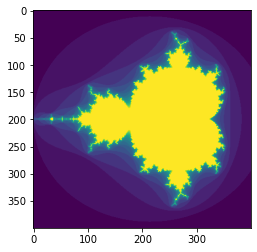

In [759]:
import numpy as np

import matplotlib.pyplot as plt

def mandelbrot( h,w, maxit=20 ):
    """Returns an image of the Mandelbrot fractal of size (h,w)."""
    y,x = np.ogrid[ -1.4:1.4:h*1j, -2:0.8:w*1j ]
    c = x+y*1j
    z = c
    divtime = maxit + np.zeros(z.shape, dtype=int)
    
    for i in range(maxit):
        z = z**2 + c
        diverge = z*np.conj(z) > 2**2            # who is diverging
        div_now = diverge & (divtime==maxit)  # who is diverging now
        divtime[div_now] = i                  # note when
        z[diverge] = 2                        # avoid diverging too much

    return divtime

plt.imshow(mandelbrot(400,400))

###### The ix_() function

The ix_ function can be used to combine different vectors so as to obtain the result for each n-uplet. For example, if you want to compute all the a+b*c for all the triplets taken from each of the vectors a, b and c:

In [765]:
a = np.array([2,3,4,5])
b = np.array([8,5,4])
c = np.array([5,4,6,8,3])
ax,bx,cx = np.ix_(a,b,c)
ax

array([[[2]],

       [[3]],

       [[4]],

       [[5]]])

In [766]:
bx

array([[[8],
        [5],
        [4]]])

In [767]:
cx

array([[[5, 4, 6, 8, 3]]])

In [768]:
ax.shape, bx.shape, cx.shape

((4, 1, 1), (1, 3, 1), (1, 1, 5))

In [769]:
result = ax+bx*cx

In [770]:
result

array([[[42, 34, 50, 66, 26],
        [27, 22, 32, 42, 17],
        [22, 18, 26, 34, 14]],

       [[43, 35, 51, 67, 27],
        [28, 23, 33, 43, 18],
        [23, 19, 27, 35, 15]],

       [[44, 36, 52, 68, 28],
        [29, 24, 34, 44, 19],
        [24, 20, 28, 36, 16]],

       [[45, 37, 53, 69, 29],
        [30, 25, 35, 45, 20],
        [25, 21, 29, 37, 17]]])

In [771]:
result[3,2,4]

17

In [772]:
a[3]+b[2]*c[4]

17

You could also implement the reduce as follows:

In [773]:
def ufunc_reduce(ufct, *vectors):
    vs = np.ix_(*vectors)
    r = ufct.identity
    for v in vs:
         r = ufct(r,v)
    return r

In [774]:
ufunc_reduce(np.add,a,b,c)

array([[[15, 14, 16, 18, 13],
        [12, 11, 13, 15, 10],
        [11, 10, 12, 14,  9]],

       [[16, 15, 17, 19, 14],
        [13, 12, 14, 16, 11],
        [12, 11, 13, 15, 10]],

       [[17, 16, 18, 20, 15],
        [14, 13, 15, 17, 12],
        [13, 12, 14, 16, 11]],

       [[18, 17, 19, 21, 16],
        [15, 14, 16, 18, 13],
        [14, 13, 15, 17, 12]]])

The advantage of this version of reduce compared to the normal ufunc.reduce is that it makes use of the broadcasting rules in order to avoid creating an argument array the size of the output times the number of vectors.

###### What’s the difference between a Python list and a NumPy array?

1. NumPy gives you an enormous range of fast and efficient ways of creating arrays and manipulating numerical data inside them. While a Python list can contain different data types within a single list, all of the elements in a NumPy array should be homogeneous.

2. NumPy arrays are faster and more compact than Python lists. An array consumes less memory and is convenient to use. NumPy uses much less memory to store data and it provides a mechanism of specifying the data types.

###### What is an array?

An array is a central data structure of the NumPy library. An array is a grid of values and it contains information about the raw data, how to locate an element, and how to interpret an element. It has a grid of elements that can be indexed in various ways. The elements are all of the same type, referred to as the array dtype.

An array can be indexed by a tuple of nonnegative integers, by booleans, by another array, or by integers. The rank of the array is the number of dimensions. The shape of the array is a tuple of integers giving the size of the array along each dimension.

One way we can initialize NumPy arrays is from Python lists, using nested lists for two- or higher-dimensional data.

In [775]:
a = np.array([1, 2, 3, 4, 5, 6])
a

array([1, 2, 3, 4, 5, 6])

In [776]:
a = np.array([[1, 2, 3, 4], [5, 6, 7, 8], [9, 10, 11, 12]])

In [777]:
a

array([[ 1,  2,  3,  4],
       [ 5,  6,  7,  8],
       [ 9, 10, 11, 12]])

We can access the elements in the array using square brackets. When you’re accessing elements, remember that indexing in NumPy starts at 0. That means that if you want to access the first element in your array, you’ll be accessing element “0”.

In [778]:
a[0]

array([1, 2, 3, 4])

In [779]:
a[0][0]

1

You might occasionally hear an array referred to as a “ndarray,” which is shorthand for “N-dimensional array.” An N-dimensional array is simply an array with any number of dimensions. You might also hear 1-D, or one-dimensional array, 2-D, or two-dimensional array, and so on. The NumPy ndarray class is used to represent both matrices and vectors

A vector is an array with a single dimension (there’s no difference between row and column vectors), while a matrix refers to an array with two dimensions. For 3-D or higher dimensional arrays, the term tensor is also commonly used

###### What are the attributes of an array?

An array is usually a fixed-size container of items of the same type and size

The number of dimensions and items in an array is defined by its shape. The shape of an array is a tuple of non-negative integers that specify the sizes of each dimension.

In NumPy, dimensions are called axes. This means that if you have a 2D array that looks like this:

In [780]:
[[0., 0., 0.],
 [1., 1., 1.]]

[[0.0, 0.0, 0.0], [1.0, 1.0, 1.0]]

Your array has 2 axes. The first axis has a length of 2 and the second axis has a length of 3.

Just like in other Python container objects, the contents of an array can be accessed and modified by indexing or slicing the array. Unlike the typical container objects, different arrays can share the same data, so changes made on one array might be visible in another.

Array attributes reflect information intrinsic to the array itself. If you need to get, or even set, properties of an array without creating a new array, you can often access an array through its attributes

###### How to create a basic array

np.array(), np.zeros(), np.ones(), np.empty(), np.arange(), np.linspace()

In [781]:
a = np.array([1, 2, 3])
a

array([1, 2, 3])

In [782]:
np.zeros(2)

array([0., 0.])

In [783]:
np.ones(2)

array([1., 1.])

In [784]:
np.empty(2)

array([1., 1.])

In [785]:
np.arange(4)

array([0, 1, 2, 3])

And even an array that contains a range of evenly spaced intervals. To do this, you will specify the first number, last number, and the step size.

In [786]:
np.arange(2, 9, 2)

array([2, 4, 6, 8])

In [787]:
np.linspace(0, 10, num=5)

array([ 0. ,  2.5,  5. ,  7.5, 10. ])

While the default data type is floating point (np.float64), you can explicitly specify which data type you want using the dtype keyword.

In [788]:
x = np.ones(2, dtype=np.int64)
x

array([1, 1], dtype=int64)

###### Adding, removing, and sorting elements

np.sort(), np.concatenate()

Sorting an element is simple with np.sort(). You can specify the axis, kind, and order when you call the function.

In [789]:
arr = np.array([2, 1, 5, 3, 7, 4, 6, 8])

In [790]:
np.sort(arr)

array([1, 2, 3, 4, 5, 6, 7, 8])

In addition to sort, which returns a sorted copy of an array, you can use:

    argsort, which is an indirect sort along a specified axis,

    lexsort, which is an indirect stable sort on multiple keys,

    searchsorted, which will find elements in a sorted array, and

    partition, which is a partial sort.


In [792]:
arr.reshape(4,2)

array([[2, 1],
       [5, 3],
       [7, 4],
       [6, 8]])

In [794]:
arr[np.newaxis, :]

array([[2, 1, 5, 3, 7, 4, 6, 8]])

In [795]:
a = np.array([[1 , 2, 3, 4], [5, 6, 7, 8], [9, 10, 11, 12]])
a

array([[ 1,  2,  3,  4],
       [ 5,  6,  7,  8],
       [ 9, 10, 11, 12]])

In [796]:
a[a < 5]

array([1, 2, 3, 4])

In [797]:
five_up = (a >= 5)
print(a[five_up])

[ 5  6  7  8  9 10 11 12]


In [798]:
a[a%2==0]

array([ 2,  4,  6,  8, 10, 12])

In [800]:
a[(a>5) & (a<11)]

array([ 6,  7,  8,  9, 10])

###### Generating random numbers

The use of random number generation is an important part of the configuration and evaluation of many numerical and machine learning algorithms. Whether you need to randomly initialize weights in an artificial neural network, split data into random sets, or randomly shuffle your dataset, being able to generate random numbers (actually, repeatable pseudo-random numbers) is essential.

With Generator.integers, you can generate random integers from low (remember that this is inclusive with NumPy) to high (exclusive). You can set endpoint=True to make the high number inclusive.

You can generate a 2 x 4 array of random integers between 0 and 4 with:

In [801]:
rng = np.random.default_rng(0)
rng.integers(5, size=(2, 4))

array([[4, 3, 2, 1],
       [1, 0, 0, 0]], dtype=int64)

In [802]:
a = np.array([11, 11, 12, 13, 14, 15, 16, 17, 12, 13, 11, 14, 18, 19, 20])
a

array([11, 11, 12, 13, 14, 15, 16, 17, 12, 13, 11, 14, 18, 19, 20])

you can use np.unique to print the unique values in your array:

In [803]:
np.unique(a)

array([11, 12, 13, 14, 15, 16, 17, 18, 19, 20])

In [804]:
np.unique(a, return_index=True) #returns unique values indices

(array([11, 12, 13, 14, 15, 16, 17, 18, 19, 20]),
 array([ 0,  2,  3,  4,  5,  6,  7, 12, 13, 14], dtype=int64))

You can pass the return_counts argument in np.unique() along with your array to get the frequency count of unique values in a NumPy array.

In [805]:
np.unique(a, return_counts=True)

(array([11, 12, 13, 14, 15, 16, 17, 18, 19, 20]),
 array([3, 2, 2, 2, 1, 1, 1, 1, 1, 1], dtype=int64))

In [806]:
a_2d = np.array([[1, 2, 3, 4], [5, 6, 7, 8], [9, 10, 11, 12], [1, 2, 3, 4]])

In [807]:
a_2d

array([[ 1,  2,  3,  4],
       [ 5,  6,  7,  8],
       [ 9, 10, 11, 12],
       [ 1,  2,  3,  4]])

In [809]:
np.unique(a_2d)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

If the axis argument isn’t passed, your 2D array will be flattened.

If you want to get the unique rows or columns, make sure to pass the axis argument. To find the unique rows, specify axis=0 and for columns, specify axis=1.

In [810]:
np.unique(a_2d, axis=0)

array([[ 1,  2,  3,  4],
       [ 5,  6,  7,  8],
       [ 9, 10, 11, 12]])

To get the unique rows, index position, and occurrence count, you can use:

In [812]:
np.unique(a_2d, axis=0, return_counts=True, return_index=True)

(array([[ 1,  2,  3,  4],
        [ 5,  6,  7,  8],
        [ 9, 10, 11, 12]]),
 array([0, 1, 2], dtype=int64),
 array([2, 1, 1], dtype=int64))

###### How to reverse an array

NumPy’s np.flip() function allows you to flip, or reverse, the contents of an array along an axis. When using np.flip, specify the array you would like to reverse and the axis. If you don’t specify the axis, NumPy will reverse the contents along all of the axes of your input array.

In [813]:
arr = np.array([1, 2, 3, 4, 5, 6, 7, 8])
np.flip(arr)

array([8, 7, 6, 5, 4, 3, 2, 1])

In [816]:
arr = np.array([[1, 2, 3, 4], [5, 6, 7, 8], [9, 10, 11, 12]])
np.flip(arr)

array([[12, 11, 10,  9],
       [ 8,  7,  6,  5],
       [ 4,  3,  2,  1]])

In [818]:
np.flip(arr, axis=0)

array([[ 9, 10, 11, 12],
       [ 5,  6,  7,  8],
       [ 1,  2,  3,  4]])

In [819]:
np.flip(arr, axis=1)

array([[ 4,  3,  2,  1],
       [ 8,  7,  6,  5],
       [12, 11, 10,  9]])

###### How to save and load NumPy objects

np.save, np.savez, np.savetxt, np.load, np.loadtxt

 there are several ways to save and load objects with NumPy. The ndarray objects can be saved to and loaded from the disk files with loadtxt and savetxt functions that handle normal text files, load and save functions that handle NumPy binary files with a .npy file extension, and a savez function that handles NumPy files with a .npz file extension.

The .npy and .npz files store data, shape, dtype, and other information required to reconstruct the ndarray in a way that allows the array to be correctly retrieved, even when the file is on another machine with different architecture.

If you want to store a single ndarray object, store it as a .npy file using np.save. If you want to store more than one ndarray object in a single file, save it as a .npz file using np.savez. You can also save several arrays into a single file in compressed npz format with savez_compressed.

It’s easy to save and load and array with np.save(). Just make sure to specify the array you want to save and a file name

In [822]:
a = np.array([1, 2, 3, 4, 5, 6])

In [823]:
np.save('filename', a)

In [824]:
b = np.load('filename.npy')
b

array([1, 2, 3, 4, 5, 6])

In [825]:
a

array([1, 2, 3, 4, 5, 6])

In [826]:
csv_arr = np.array([1, 2, 3, 4, 5, 6, 7, 8])

In [827]:
np.savetxt('new_file.csv', csv_arr)

In [828]:
np.loadtxt('new_file.csv')

array([1., 2., 3., 4., 5., 6., 7., 8.])

The savetxt() and loadtxt() functions accept additional optional parameters such as header, footer, and delimiter. While text files can be easier for sharing, .npy and .npz files are smaller and faster to read. If you need more sophisticated handling of your text file (for example, if you need to work with lines that contain missing values), you will want to use the genfromtxt function.

With savetxt, you can specify headers, footers, comments, and more.

###### Plotting arrays with Matplotlib

In [829]:
a = np.array([2, 1, 5, 7, 4, 6, 8, 14, 10, 9, 18, 20, 22])

In [830]:
import matplotlib.pyplot as plt

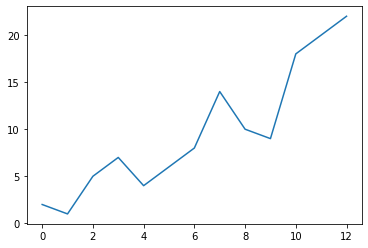

In [831]:
plt.plot(a)

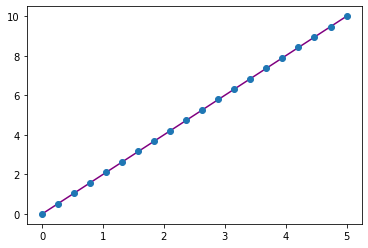

In [833]:
x = np.linspace(0,5,20)
y = np.linspace(0,10,20)
plt.plot(x,y, 'purple')
plt.plot(x,y,'o')

With Matplotlib, you have access to an enormous number of visualization options.

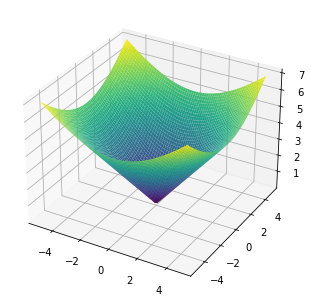

In [837]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = Axes3D(fig)
X = np.arange(-5, 5, 0.15)
Y = np.arange(-5, 5, 0.15)
X, Y = np.meshgrid(X, Y)
Z = np.sqrt(X**2 + Y**2)


ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap='viridis')

In [838]:
np.iinfo(int)

iinfo(min=-2147483648, max=2147483647, dtype=int32)

In [840]:
np.finfo(float)

finfo(resolution=1e-15, min=-1.7976931348623157e+308, max=1.7976931348623157e+308, dtype=float64)

###### Array creation

There are 5 general mechanisms for creating arrays:

1. Conversion from other Python structures (e.g., lists, tuples)
2. Intrinsic numpy array creation objects (e.g., arange, ones, zeros, etc.)
3. Reading arrays from disk, either from standard or custom formats
4. Creating arrays from raw bytes through the use of strings or buffers
5. Use of special library functions (e.g., random)


In [845]:
x = np.array([2,3,1,0])
x

array([2, 3, 1, 0])

In [847]:
x = np.array([[1,2.0],[0,0],(1+1j,3.)])
x

array([[1.+0.j, 2.+0.j],
       [0.+0.j, 0.+0.j],
       [1.+1.j, 3.+0.j]])

In [848]:
x = np.array([[ 1.+0.j, 2.+0.j], [ 0.+0.j, 0.+0.j], [ 1.+1.j, 3.+0.j]])
x

array([[1.+0.j, 2.+0.j],
       [0.+0.j, 0.+0.j],
       [1.+1.j, 3.+0.j]])

In [849]:
np.zeros((2, 3))

array([[0., 0., 0.],
       [0., 0., 0.]])

In [850]:
np.arange(10)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [851]:
np.arange(2, 10, dtype=float)

array([2., 3., 4., 5., 6., 7., 8., 9.])

In [852]:
np.arange(2, 3, 0.1)

array([2. , 2.1, 2.2, 2.3, 2.4, 2.5, 2.6, 2.7, 2.8, 2.9])

In [853]:
np.linspace(1., 4., 6)

array([1. , 1.6, 2.2, 2.8, 3.4, 4. ])

In [854]:
np.indices((3,3))

array([[[0, 0, 0],
        [1, 1, 1],
        [2, 2, 2]],

       [[0, 1, 2],
        [0, 1, 2],
        [0, 1, 2]]])

###### Reading Arrays From Disk

###### Standard Binary Formats

Various fields have standard formats for array data. The following lists the ones with known python libraries to read them and return numpy arrays

HDF5: h5py

FITS: Astropy

Examples of formats that cannot be read directly but for which it is not hard to convert are those formats supported by libraries like PIL (able to read and write many image formats such as jpg, png, etc).

Comma Separated Value files (CSV) are widely used (and an export and import option for programs like Excel). There are a number of ways of reading these files in Python. There are CSV functions in Python and functions in pylab (part of matplotlib).

More generic ascii files can be read using the io package in scipy.

There are a variety of approaches one can use. If the file has a relatively simple format then one can write a simple I/O library and use the numpy fromfile() function and .tofile() method to read and write numpy arrays directly (mind your byteorder though!) If a good C or C++ library exists that read the data, one can wrap that library with a variety of techniques though that certainly is much more work and requires significantly more advanced knowledge to interface with C or C++.

There are libraries that can be used to generate arrays for special purposes and it isn’t possible to enumerate all of them. The most common uses are use of the many array generation functions in random that can generate arrays of random values, and some utility functions to generate special matrices (e.g. diagonal).

###### Indexing

In [855]:
y = np.arange(35).reshape(5,7)
y

array([[ 0,  1,  2,  3,  4,  5,  6],
       [ 7,  8,  9, 10, 11, 12, 13],
       [14, 15, 16, 17, 18, 19, 20],
       [21, 22, 23, 24, 25, 26, 27],
       [28, 29, 30, 31, 32, 33, 34]])

In [856]:
y[1:5:2,::3]

array([[ 7, 10, 13],
       [21, 24, 27]])

In [857]:
y[np.nonzero(y>20)]

array([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34])

###### Structured arrays

Structured arrays are ndarrays whose datatype is a composition of simpler datatypes organized as a sequence of named fields. For example,

In [858]:
x = np.array([('Rex', 9, 81.0), ('Fido', 3, 27.0)],
             dtype=[('name', 'U10'), ('age', 'i4'), ('weight', 'f4')])

In [859]:
x

array([('Rex', 9, 81.), ('Fido', 3, 27.)],
      dtype=[('name', '<U10'), ('age', '<i4'), ('weight', '<f4')])

Here x is a one-dimensional array of length two whose datatype is a structure with three fields: 1. A string of length 10 or less named ‘name’, 2. a 32-bit integer named ‘age’, and 3. a 32-bit float named ‘weight’.

If you index x at position 1 you get a structure:

In [860]:
x[1]

('Fido', 3, 27.)

In [861]:
x[1][0]

'Fido'

You can access and modify individual fields of a structured array by indexing with the field name:

In [862]:
x['age']

array([9, 3])

In [863]:
x['weight']

array([81., 27.], dtype=float32)

Structured datatypes are designed to be able to mimic ‘structs’ in the C language, and share a similar memory layout. They are meant for interfacing with C code and for low-level manipulation of structured buffers, for example for interpreting binary blobs. For these purposes they support specialized features such as subarrays, nested datatypes, and unions, and allow control over the memory layout of the structure.

A structured datatype can be thought of as a sequence of bytes of a certain length (the structure’s itemsize) which is interpreted as a collection of fields. Each field has a name, a datatype, and a byte offset within the structure. The datatype of a field may be any numpy datatype including other structured datatypes, and it may also be a subarray data type which behaves like an ndarray of a specified shape. The offsets of the fields are arbitrary, and fields may even overlap. These offsets are usually determined automatically by numpy, but can also be specified

###### numpy I/O

###### Importing data with genfromtxt

NumPy provides several functions to create arrays from tabular data. We focus here on the genfromtxt function.

In a nutshell, genfromtxt runs two main loops. The first loop converts each line of the file in a sequence of strings. The second loop converts each string to the appropriate data type. This mechanism is slower than a single loop, but gives more flexibility. In particular, genfromtxt is able to take missing data into account, when other faster and simpler functions like loadtxt cannot.

In [865]:
import numpy as np
from io import StringIO

The only mandatory argument of genfromtxt is the source of the data. It can be a string, a list of strings, a generator or an open file-like object with a read method, for example, a file or io.StringIO object. If a single string is provided, it is assumed to be the name of a local or remote file. If a list of strings or a generator returning strings is provided, each string is treated as one line in a file. When the URL of a remote file is passed, the file is automatically downloaded to the current directory and opened.

Recognized file types are text files and archives. Currently, the function recognizes gzip and bz2 (bzip2) archives. The type of the archive is determined from the extension of the file: if the filename ends with '.gz', a gzip archive is expected; if it ends with 'bz2', a bzip2 archive is assumed.

###### The delimiter argument

Once the file is defined and open for reading, genfromtxt splits each non-empty line into a sequence of strings. Empty or commented lines are just skipped. The delimiter keyword is used to define how the splitting should take place.

Quite often, a single character marks the separation between columns. For example, comma-separated files (CSV) use a comma (,) or a semicolon (;) as delimiter:

In [866]:
data = u"1, 2, 3\n4, 5, 6"
np.genfromtxt(StringIO(data), delimiter=",")

array([[1., 2., 3.],
       [4., 5., 6.]])

Another common separator is "\t", the tabulation character. However, we are not limited to a single character, any string will do. By default, genfromtxt assumes delimiter=None, meaning that the line is split along white spaces (including tabs) and that consecutive white spaces are considered as a single white space.

Alternatively, we may be dealing with a fixed-width file, where columns are defined as a given number of characters. In that case, we need to set delimiter to a single integer (if all the columns have the same size) or to a sequence of integers (if columns can have different sizes):

In [867]:
data = u"  1  2  3\n  4  5 67\n890123  4"
np.genfromtxt(StringIO(data), delimiter=3)

array([[  1.,   2.,   3.],
       [  4.,   5.,  67.],
       [890., 123.,   4.]])

In [868]:
data = u"123456789\n   4  7 9\n   4567 9"
np.genfromtxt(StringIO(data), delimiter=(4, 3, 2))

array([[1234.,  567.,   89.],
       [   4.,    7.,    9.],
       [   4.,  567.,    9.]])

###### The autostrip argument

By default, when a line is decomposed into a series of strings, the individual entries are not stripped of leading nor trailing white spaces. This behavior can be overwritten by setting the optional argument autostrip to a value of True:

In [869]:
data = u"1, abc , 2\n 3, xxx, 4"
np.genfromtxt(StringIO(data), delimiter=",", dtype="|U5")

array([['1', ' abc ', ' 2'],
       ['3', ' xxx', ' 4']], dtype='<U5')

In [870]:
np.genfromtxt(StringIO(data), delimiter=",", dtype="|U5", autostrip=True)

array([['1', 'abc', '2'],
       ['3', 'xxx', '4']], dtype='<U5')

###### The comments argument

The optional argument comments is used to define a character string that marks the beginning of a comment. By default, genfromtxt assumes comments='#'. The comment marker may occur anywhere on the line. Any character present after the comment marker(s) is simply ignored:

In [871]:
data = u"""#
... # Skip me !
... # Skip me too !
... 1, 2
... 3, 4
... 5, 6 #This is the third line of the data
... 7, 8
... # And here comes the last line
... 9, 0
... """

In [872]:
np.genfromtxt(StringIO(data), comments="#", delimiter=",")

array([[1., 2.],
       [3., 4.],
       [5., 6.],
       [7., 8.],
       [9., 0.]])

###### The skip_header and skip_footer arguments

The presence of a header in the file can hinder data processing. In that case, we need to use the skip_header optional argument. The values of this argument must be an integer which corresponds to the number of lines to skip at the beginning of the file, before any other action is performed. Similarly, we can skip the last n lines of the file by using the skip_footer attribute and giving it a value of n:

In [873]:
data = u"\n".join(str(i) for i in range(10))
np.genfromtxt(StringIO(data),)

array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.])

In [874]:
np.genfromtxt(StringIO(data),
...               skip_header=3, skip_footer=5)

array([3., 4.])

By default, skip_header=0 and skip_footer=0, meaning that no lines are skipped.

###### The usecols argument

In some cases, we are not interested in all the columns of the data but only a few of them. We can select which columns to import with the usecols argument. This argument accepts a single integer or a sequence of integers corresponding to the indices of the columns to import. Remember that by convention, the first column has an index of 0. Negative integers behave the same as regular Python negative indexes.

For example, if we want to import only the first and the last columns, we can use usecols=(0, -1):

In [875]:
data = u"1 2 3\n4 5 6"
np.genfromtxt(StringIO(data), usecols=(0, -1))

array([[1., 3.],
       [4., 6.]])

If the columns have names, we can also select which columns to import by giving their name to the usecols argument, either as a sequence of strings or a comma-separated string:

In [877]:
data = u"1 2 3\n4 5 6"
np.genfromtxt(StringIO(data),
              names="a, b, c", usecols=("a", "c"))

array([(1., 3.), (4., 6.)], dtype=[('a', '<f8'), ('c', '<f8')])

###### Choosing the data type

The main way to control how the sequences of strings we have read from the file are converted to other types is to set the dtype argument. Acceptable values for this argument are:

    a single type, such as dtype=float. The output will be 2D with the given dtype, unless a name has been associated with each column with the use of the names argument (see below). Note that dtype=float is the default for genfromtxt.

    a sequence of types, such as dtype=(int, float, float).

    a comma-separated string, such as dtype="i4,f8,|U3".

    a dictionary with two keys 'names' and 'formats'.

    a sequence of tuples (name, type), such as dtype=[('A', int), ('B', float)].

    an existing numpy.dtype object.

    the special value None. In that case, the type of the columns will be determined from the data itself (see below).

In all the cases but the first one, the output will be a 1D array with a structured dtype. This dtype has as many fields as items in the sequence. The field names are defined with the names keyword.

When dtype=None, the type of each column is determined iteratively from its data. We start by checking whether a string can be converted to a boolean (that is, if the string matches true or false in lower cases); then whether it can be converted to an integer, then to a float, then to a complex and eventually to a string. This behavior may be changed by modifying the default mapper of the StringConverter class.

The option dtype=None is provided for convenience. However, it is significantly slower than setting the dtype explicitly.

###### The names argument

A natural approach when dealing with tabular data is to allocate a name to each column. A first possibility is to use an explicit structured dtype, as mentioned previously:

In [878]:
data = StringIO("1 2 3\n 4 5 6")
np.genfromtxt(data, dtype=[(_, int) for _ in "abc"])

array([(1, 2, 3), (4, 5, 6)],
      dtype=[('a', '<i4'), ('b', '<i4'), ('c', '<i4')])

Another simpler possibility is to use the names keyword with a sequence of strings or a comma-separated string:

In [879]:
data = StringIO("1 2 3\n 4 5 6")
np.genfromtxt(data, names="A, B, C")

array([(1., 2., 3.), (4., 5., 6.)],
      dtype=[('A', '<f8'), ('B', '<f8'), ('C', '<f8')])

###### Linear algebra on n-dimensional arrays

In [880]:
from scipy import misc

img = misc.face()

In [881]:
type(img)

numpy.ndarray

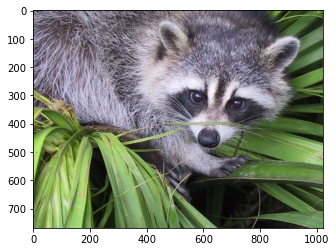

In [882]:
import matplotlib.pyplot as plt
>>> plt.imshow(img)

###### Shape, axis and array properties

Note that, in linear algebra, the dimension of a vector refers to the number of entries in an array. In NumPy, it instead defines the number of axes. For example, a 1D array is a vector such as [1, 2, 3], a 2D array is a matrix, and so forth.

First, let’s check for the shape of the data in our array. Since this image is two-dimensional (the pixels in the image form a rectangle), we might expect a two-dimensional array to represent it (a matrix). However, using the shape property of this NumPy array gives us a different result:

In [883]:
img.shape

(768, 1024, 3)

The output is a tuple with three elements, which means that this is a three-dimensional array. In fact, since this is a color image, and we have used the imread function to read it, the data is organized in three 2D arrays, representing color channels (in this case, red, green and blue - RGB). You can see this by looking at the shape above: it indicates that we have an array of 3 matrices, each having shape 768x1024.

Furthermore, using the ndim property of this array, we can see that

In [884]:
img.ndim

3

NumPy refers to each dimension as an axis. Because of how imread works, the first index in the 3rd axis is the red pixel data for our image. We can access this by using the syntax

In [885]:
img[:, :, 0]

array([[121, 138, 153, 155, 155, 158, 159, 156, 147, 137, 122, 106,  92,
         80,  70,  64,  52,  47,  40,  36,  33,  35,  42,  48,  43,  50,
         55,  57,  57,  53,  51,  51,  43,  42,  49,  67,  92, 117, 133,
        138, 135, 134, 130, 123, 119, 121, 122, 120, 122, 143, 165, 176,
        186, 188, 169, 145, 125, 115, 103,  96,  92,  89,  83,  80, 112,
        128, 144, 147, 139, 128, 124, 123, 101,  85,  72,  76,  87,  91,
         90,  88,  79,  84,  84,  69,  47,  43,  75, 112, 136, 136, 126,
        108,  97,  98, 106, 111, 105, 108, 101,  91,  87,  90, 107, 131,
        134, 125, 116, 109, 107, 106, 107, 108, 102,  82,  70,  70,  73,
         92, 122, 141, 157, 163, 163, 155, 147, 145, 147, 150, 155, 165,
        171, 168, 162, 158, 153, 149, 120, 119, 119, 125, 135, 136, 120,
        100,  86,  87,  97, 109, 107,  90,  74,  71, 123, 151, 160, 133,
        115, 132, 161, 177, 192, 182, 167, 161, 173, 190, 192, 183, 165,
        115,  82,  95, 116, 114, 108, 110, 120, 111

From the output above, we can see that every value in img[:,:,0] is an integer value between 0 and 255, representing the level of red in each corresponding image pixel

As expected, this is a 768x1024 matrix:

In [886]:
img[:, :, 0].shape

(768, 1024)

Since we are going to perform linear algebra operations on this data, it might be more interesting to have real numbers between 0 and 1 in each entry of the matrices to represent the RGB values. We can do that by setting

In [887]:
img_array = img / 255

This operation, dividing an array by a scalar, works because of NumPy’s broadcasting rules). (Note that in real-world applications, it would be better to use, for example, the img_as_float utility function from scikit-image).

You can check that the above works by doing some tests; for example, inquiring about maximum and minimum values for this array:

In [888]:
img_array.max(), img_array.min()

(1.0, 0.0)

In [889]:
img_array.dtype

dtype('float64')

Note that we can assign each color channel to a separate matrix using the slice syntax:

In [892]:
red_array = img_array[:, :, 0]
green_array = img_array[:, :, 1]
blue_array = img_array[:, :, 2]

###### Operations on an axis

It is possible to use methods from linear algebra to approximate an existing set of data. Here, we will use the SVD (Singular Value Decomposition) to try to rebuild an image that uses less singular value information than the original one, while still retaining some of its features.

To proceed, import the linear algebra submodule from NumPy:

In [893]:
from numpy import linalg

In order to extract information from a given matrix, we can use the SVD to obtain 3 arrays which can be multiplied to obtain the original matrix. From the theory of linear algebra, given a matrix A, the following product can be computed:

U \Sigma V^T = A

where U and V^T are square and \Sigma is the same size as A. \Sigma is a diagonal matrix and contains the singular values of A, organized from largest to smallest. These values are always non-negative and can be used as an indicator of the “importance” of some features represented by the matrix A.

Let’s see how this works in practice with just one matrix first. Note that according to colorimetry, it is possible to obtain a fairly reasonable grayscale version of our color image if we apply the formula

Y = 0.2126 R + 0.7152 G + 0.0722 B

where Y is the array representing the grayscale image, and R, G and B are the red, green and blue channel arrays we had originally. Notice we can use the @ operator (the matrix multiplication operator for NumPy arrays, see numpy.matmul) for this:

In [894]:
img_gray = img_array @ [0.2126, 0.7152, 0.0722]

In [895]:
img_gray.shape

(768, 1024)

In [896]:
img_gray

array([[4.52098824e-01, 5.18765490e-01, 5.78155294e-01, 5.85998431e-01,
        5.85998431e-01, 5.95524706e-01, 5.99446275e-01, 5.87681569e-01,
        5.54625882e-01, 5.15410196e-01, 4.56020392e-01, 3.92709020e-01,
        3.40328627e-01, 2.92703529e-01, 2.53487843e-01, 2.29392157e-01,
        1.83465882e-01, 1.63858039e-01, 1.36407059e-01, 1.11740392e-01,
        9.99756863e-02, 1.07818824e-01, 1.29377255e-01, 1.52906667e-01,
        1.33298824e-01, 1.57661961e-01, 1.77269804e-01, 1.85112941e-01,
        1.76132549e-01, 1.60446275e-01, 1.52603137e-01, 1.52603137e-01,
        1.31909804e-01, 1.27988235e-01, 1.55439216e-01, 2.26027451e-01,
        3.29959216e-01, 4.27432157e-01, 4.90177255e-01, 5.18765490e-01,
        5.07000784e-01, 5.08971765e-01, 4.92719216e-01, 4.65268235e-01,
        4.58562353e-01, 4.66405490e-01, 4.70327059e-01, 4.62483922e-01,
        4.87181961e-01, 5.69534902e-01, 6.46829020e-01, 6.89966275e-01,
        7.26094118e-01, 7.28044706e-01, 6.53534902e-01, 5.597003

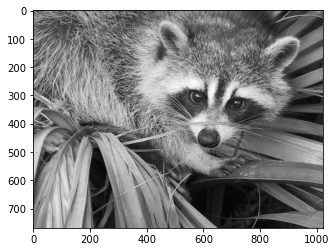

In [897]:
plt.imshow(img_gray, cmap="gray")

Now, applying the linalg.svd function to this matrix, we obtain the following decomposition:

In [898]:
U, s, Vt = linalg.svd(img_gray)

In [899]:
U.shape, s.shape, Vt.shape

((768, 768), (768,), (1024, 1024))

Note that s has a particular shape: it has only one dimension. This means that some linear algebra functions that expect 2d arrays might not work. For example, from the theory, one might expect s and Vt to be compatible for multiplication. However, this is not true as s does not have a second axis. Executing

In [900]:
s @ Vt

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 1024 is different from 768)

results in a ValueError. This happens because having a one-dimensional array for s, in this case, is much more economic in practice than building a diagonal matrix with the same data. To reconstruct the original matrix, we can rebuild the diagonal matrix \Sigma with the elements of s in its diagonal and with the appropriate dimensions for multiplying: in our case, \Sigma should be 768x1024 since U is 768x768 and Vt is 1024x1024.

In [901]:
>>> import numpy as np
>>> Sigma = np.zeros((768, 1024))
>>> for i in range(768):
...     Sigma[i, i] = s[i]

Now, we want to check if the reconstructed U @ Sigma @ Vt is close to the original img_gray matrix.

The linalg module includes a norm function, which computes the norm of a vector or matrix represented in a NumPy array. For example, from the SVD explanation above, we would expect the norm of the difference between img_gray and the reconstructed SVD product to be small. As expected, you should see something like

In [902]:
linalg.norm(img_gray - U @ Sigma @ Vt)

1.5622983593823518e-12

We could also have used the numpy.allclose function to make sure the reconstructed product is, in fact, close to our original matrix (the difference between the two arrays is small):

In [903]:
>>> np.allclose(img_gray, U @ Sigma @ Vt)

True

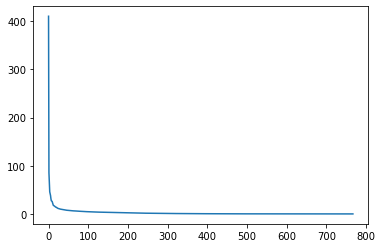

In [904]:
 plt.plot(s)

In the graph, we can see that although we have 768 singular values in s, most of those (after the 150th entry or so) are pretty small. So it might make sense to use only the information related to the first (say, 50) singular values to build a more economical approximation to our image.

The idea is to consider all but the first k singular values in Sigma (which are the same as in s) as zeros, keeping U and Vt intact, and computing the product of these matrices as the approximation.

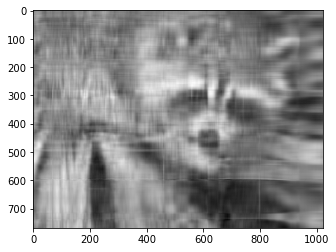

In [905]:
k = 10
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

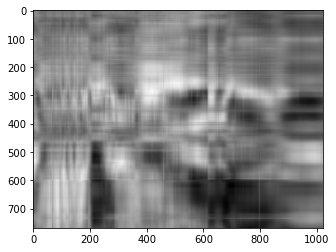

In [906]:
k = 5
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

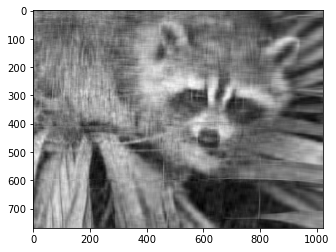

In [907]:
k = 20
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

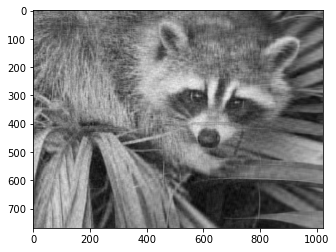

In [908]:
k = 40
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

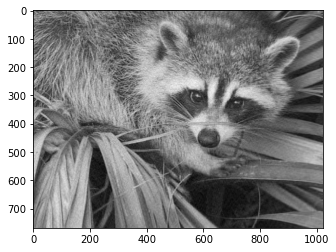

In [909]:
k = 100
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

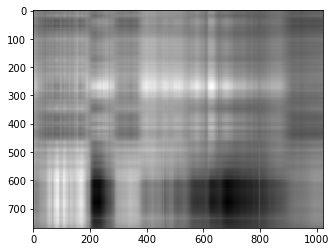

In [912]:
k = 2
approx = U @ Sigma[:, :k] @ Vt[:k, :]
plt.imshow(approx, cmap="gray")

###### Applying to all colors

Now we want to do the same kind of operation, but to all three colors. Our first instinct might be to repeat the same operation we did above to each color matrix individually. However, NumPy’s broadcasting takes care of this for us.

If our array has more than two dimensions, then the SVD can be applied to all axes at once. However, the linear algebra functions in NumPy expect to see an array of the form (N, M, M), where the first axis represents the number of matrices.

In [913]:
img_array.shape

(768, 1024, 3)

In [915]:
img_array_transposed = np.transpose(img_array, (2, 0, 1))

In [916]:
img_array_transposed.shape

(3, 768, 1024)

In [917]:
U, s, Vt = linalg.svd(img_array_transposed)

In [918]:
U.shape, s.shape, Vt.shape

((3, 768, 768), (3, 768), (3, 1024, 1024))

In [919]:
>>> Sigma = np.zeros((3, 768, 1024))
>>> for j in range(3):
...     np.fill_diagonal(Sigma[j, :, :], s[j, :])

In [920]:
reconstructed = U @ Sigma @ Vt

In [921]:
reconstructed.shape

(3, 768, 1024)

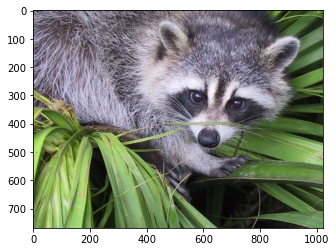

In [922]:
plt.imshow(np.transpose(reconstructed, (1, 2, 0)))

In [923]:
approx_img = U @ Sigma[..., :k] @ Vt[..., :k, :]

In [925]:
approx_img.shape

(3, 768, 1024)

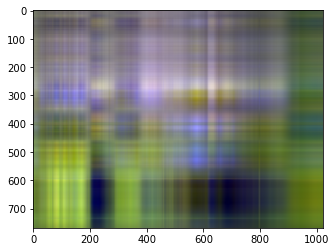

In [926]:
plt.imshow(np.transpose(approx_img, (1, 2, 0)))